The intention for t

#### **1) Libraries**

In [1]:
# !pip install -U tensorflow_probability -q

In [2]:
# prerequisites
import numpy as np
import pandas as pd
import math
import matplotlib
import matplotlib.pyplot as plt
# import seaborn as sns
# sns.set()
import tensorflow as tf
from tensorflow import keras

from tensorflow.keras.datasets import mnist
from tensorflow.keras.layers import Input, InputLayer, Lambda, Reshape, Dropout, \
                                    Flatten, Dense, Conv2D, Conv2DTranspose  
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
import tensorflow_probability as tfp
from tensorflow_probability import distributions
# from tensorflow_probability.distributions import MultivariateStudentTLinearOperator
# from keras import objectives
from scipy.stats import norm
from scipy import ndimage
from six.moves import urllib
import gzip
import time
import os

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

#### **2) MNIST Data**

Load the MNIST dataset

In [3]:
# (X_train, y_train), (X_test, y_test) = mnist.load_data()

Preprocess image

In [4]:
SOURCE_URL = 'http://yann.lecun.com/exdb/mnist/'
DATA_DIRECTORY = "data"

IMAGE_SIZE = 28
NUM_CHANNELS = 1
PIXEL_DEPTH = 255
NUM_LABELS = 10
VALIDATION_SIZE = 0  

# DOWNLOAD
def try_download(filename):
    if not tf.io.gfile.exists(DATA_DIRECTORY):
        tf.io.gfile.makedirs(DATA_DIRECTORY)
    filepath = os.path.join(DATA_DIRECTORY, filename)
    if not tf.io.gfile.exists(filepath):
        filepath, _ = urllib.request.urlretrieve(SOURCE_URL + filename, filepath)
        with tf.io.gfile.GFile(filepath) as f:
            size = f.size()
        print('Successfully downloaded', filename, size, 'bytes.')
    return filepath

# GET IMAGES
def get_data(filename, num_images, norm_shift=False, norm_scale=True):
    print('geting', filename)
    with gzip.open(filename) as bytestream:
        bytestream.read(16)
        buf = bytestream.read(IMAGE_SIZE * IMAGE_SIZE * num_images * NUM_CHANNELS)
        data = np.frombuffer(buf, dtype=np.uint8).astype(np.float32)
        if norm_shift:
            data = data - (PIXEL_DEPTH / 2.0)
        if norm_scale:
            data = data / PIXEL_DEPTH
        data = data.reshape(num_images, IMAGE_SIZE, IMAGE_SIZE, NUM_CHANNELS)
        data = np.reshape(data, [num_images, -1])
    return data

# GET LABELS
def get_labels(filename, num_images):
    """get the labels into a vector of int64 label IDs."""
    print('geting', filename)
    with gzip.open(filename) as bytestream:
        bytestream.read(8)
        buf = bytestream.read(1 * num_images)
        labels = np.frombuffer(buf, dtype=np.uint8).astype(np.int64)
        num_labels_data = len(labels)
        one_hot_encoding = np.zeros((num_labels_data,NUM_LABELS))
        one_hot_encoding[np.arange(num_labels_data),labels] = 1
        one_hot_encoding = np.reshape(one_hot_encoding, [-1, NUM_LABELS])
    return one_hot_encoding

# Augment training data
def expend_training_data(images, labels):

    expanded_images = []
    expanded_labels = []

    j = 0 
    for x, y in zip(images, labels):
        j = j+1
        if j%100==0:
            print ('expanding data : %03d / %03d' % (j, np.size(images,0)))

        # register original data
        expanded_images.append(x)
        expanded_labels.append(y)

        # get a value for the background
        # zero is the expected value, but median() is used to estimate background's value
        bg_value = np.median(x) 
        image = np.reshape(x, (-1, 28))

        for i in range(4):
            angle = np.random.randint(-15,15,1)
            new_img = ndimage.rotate(image,angle,reshape=False, cval=bg_value)

            # shift the image with random distance
            shift = np.random.randint(-2, 2, 2)
            new_img_ = ndimage.shift(new_img,shift, cval=bg_value)

            # register new training data
            expanded_images.append(np.reshape(new_img_, 784))
            expanded_labels.append(y)

    # images and labels are concatenated for random-shuffle at each epoch
    # notice that pair of image and label should not be broken
    expanded_train_total_data = np.concatenate((expanded_images, expanded_labels), axis=1)
    np.random.shuffle(expanded_train_total_data)

    return expanded_train_total_data

# MNIST DATA
def prepare_MNIST_data(use_norm_shift=False, use_norm_scale=True, use_data_augmentation=False):
    # Get the data.
    train_data_filename = try_download('train-images-idx3-ubyte.gz')
    train_labels_filename = try_download('train-labels-idx1-ubyte.gz')
    test_data_filename = try_download('t10k-images-idx3-ubyte.gz')
    test_labels_filename = try_download('t10k-labels-idx1-ubyte.gz')

    # get it into numpy arrays.
    train_data = get_data(train_data_filename, 60000, use_norm_shift, use_norm_scale)
    train_labels = get_labels(train_labels_filename, 60000)
    test_data = get_data(test_data_filename, 10000, use_norm_shift, use_norm_scale)
    test_labels = get_labels(test_labels_filename, 10000)

    # Generate a validation set.
    validation_data = train_data[:VALIDATION_SIZE, :]
    validation_labels = train_labels[:VALIDATION_SIZE,:]
    train_data = train_data[VALIDATION_SIZE:, :]
    train_labels = train_labels[VALIDATION_SIZE:,:]

    # Concatenate train_data & train_labels for random shuffle
    if use_data_augmentation:
        train_total_data = expend_training_data(train_data, train_labels)
    else:
        train_total_data = np.concatenate((train_data, train_labels), axis=1)

    train_size = train_total_data.shape[0]

    return train_total_data, train_size, train_data, train_labels, test_data, test_labels

In [5]:
#(X_train, y_train), (X_test, y_test) = mnist.load_data()
train_total_data, train_size, X_train, y_train, X_test, y_test = prepare_MNIST_data(use_norm_shift=False, use_norm_scale=True, use_data_augmentation=False)
temp = np.argmax(y_test, axis=1)
y_test = temp

geting data/train-images-idx3-ubyte.gz
geting data/train-labels-idx1-ubyte.gz
geting data/t10k-images-idx3-ubyte.gz
geting data/t10k-labels-idx1-ubyte.gz


In [6]:
# def preprocess_images(images):
#     # Shape it as (n, 784,)
#     images = images.astype('float32') / 255.
#     return images.reshape(images.shape[0], -1)

In [7]:
# X_train = preprocess_images(X_train)
# X_test = preprocess_images(X_test)
# X_train.shape, X_test.shape

#### **3) Model Class**

In [8]:
class CoupledVAE:
    def __init__(self, coupling_dist, coupling_loss, train_dim, z_dim, seed,
                 batch_size=100, n_hidden=1024, dropout=0.05, learning_rate=1e-3,
                 initializer=keras.initializers.VarianceScaling(scale=0.1, mode='fan_in', distribution='normal')
                 ):
        """Convolutional variational autoencoder."""
        # Seed
        np.random.seed(seed)
        tf.random.set_seed(seed)
        # Global variables
        self.coupling_dist = coupling_dist
        self.coupling_loss = coupling_loss
        self.z_dim = z_dim
        self.batch_size = batch_size
        self.n_hidden = n_hidden
        self.dropout = dropout
        self.initializer = initializer
        # Encoder
        x = Input(shape=train_dim)
        self.encoder = self._build_encoder_network()  # VAEEncoder
        x_encoded = self.encoder(x)
        # Latent vector
        z = self._get_latent_vector(x_encoded)
        # Decoder
        self.decoder = self._build_decoder_network(train_dim)  # VAEDecoder
        y = self.decoder(z)
        y = tf.clip_by_value(y, 1e-8, 1 - 1e-8)
        # Model
        self.model = self._build_coupled_vae(x, y, learning_rate)
        self.recognizer = Model(x, self.mean_vector)
        self.generator = self._build_generator()

    def _build_encoder_network(self):
        return keras.Sequential(
            [
                Dense(self.n_hidden, activation='elu', kernel_initializer=self.initializer),
                Dropout(self.dropout),
                Dense(self.n_hidden, activation='tanh', kernel_initializer=self.initializer),
                Dropout(self.dropout)
            ]
        )

    def _get_latent_vector(self, x_encoded):
        mean_vector = Dense(self.z_dim, kernel_initializer=self.initializer)(x_encoded)
        log_std_vector = Dense(self.z_dim, kernel_initializer=self.initializer)(x_encoded)
        # Stddev initially is log.  It gets called as an exponential when being sampled.
        std_vector = 0.000001 + (log_std_vector)
        self.mean_vector = mean_vector
        self.std_vector = std_vector
        z = Lambda(self._sampling, output_shape=(self.z_dim,))([self.mean_vector, self.std_vector])
        return z

    def _sampling(self, args):
        mean_vector, std_vector = args
        assert self.coupling_dist >= 0, "Coupling distribution variable must be greater or equal to 0." 
        if self.coupling_dist == 0:
            # Use normal Gaussian if coupling_dist == 0
            # Reparameterization trick
            epsilon = K.random_normal(shape=(self.batch_size, self.z_dim), mean=0., stddev=1.0)
        else:
            # Use Student-T (approx. coupled-Gaussian) if coupling_dist > 0
            mvt = distributions.MultivariateStudentTLinearOperator(df=1/self.coupling_dist,
                                                                   loc=np.zeros(self.z_dim),
                                                                   scale=tf.linalg.LinearOperatorLowerTriangular(np.identity(self.z_dim))
                                                                   )
            # Modify epsilon to sample from Coupled-gaussians instead of Gaussians.
            epsilon = mvt.sample(sample_shape=(self.batch_size))
            epsilon = tf.dtypes.cast(epsilon, tf.float32)
        return mean_vector + K.exp(std_vector) * epsilon

    def _build_decoder_network(self, train_dim):
        return keras.Sequential(
            [
                Dense(self.n_hidden, activation='tanh', kernel_initializer=self.initializer, bias_initializer='zeros'),
                Dropout(self.dropout),
                Dense(self.n_hidden, activation='elu', kernel_initializer=self.initializer, bias_initializer='zeros'),
                Dropout(self.dropout),
                Dense(train_dim[0], activation='sigmoid', kernel_initializer=self.initializer, bias_initializer='zeros')
            ]
        )

    def _build_coupled_vae(self, x, y, learning_rate):
        model = Model(x, y)
        model.add_loss(self._compute_loss(x, y))
        opt = keras.optimizers.Adam(learning_rate=learning_rate)
        model.compile(optimizer=opt)
        return model

    def _compute_loss(self, x, y):
        coupling_loss = self.coupling_loss
        mean_vector = self.mean_vector
        std_vector = self.std_vector
        d = self.z_dim
        d1 = 1 + 2*coupling_loss/(1 + d*coupling_loss)
        # d = 20  # What is d?
        # d1 = 1 + d*coupling_loss + 2*coupling_loss  # What is d1?
        #### Latent loss and image loss for Coupled VAE.
        marginal_likelihood = tf.reduce_sum(x * tf.subtract(tf.pow(y, (2*coupling_loss) / (1 + coupling_loss)), 1) / (2*coupling_loss) + (1 - x)
                                            * tf.subtract(tf.pow(1 - y, (2 * coupling_loss) / (1 + coupling_loss)), 1) / (coupling_loss*2), 1)
        kl_d1 = tf.reduce_prod(tf.pow(2 * tf.constant(math.pi), coupling_loss/(1 + d*coupling_loss)) * tf.sqrt(d1 / (d1 - 2*coupling_loss*tf.square(std_vector)))
                            * tf.exp(tf.square(mean_vector)*d1*coupling_loss / (1 + d*coupling_loss) / (d1 - 2*coupling_loss*tf.square(std_vector))), 1)
        kl_d2 = tf.reduce_prod(tf.pow(2 * tf.constant(math.pi)*tf.square(std_vector),
                                    coupling_loss / (1 + coupling_loss*d)) * tf.sqrt(d1 / (1 + d*coupling_loss)), 1)
        kl_divergence = (kl_d1 - kl_d2) / coupling_loss / 2
        marginal_likelihood = tf.reduce_mean(marginal_likelihood)
        # ELBO method
        elbo = marginal_likelihood - kl_divergence
        vae_loss = -elbo
        return vae_loss

    def _build_generator(self):
        decoder_input = Input(shape=(self.z_dim,))
        _y = self.decoder(decoder_input)
        generator = Model(decoder_input, _y)
        return generator

    def summary(self):
        return self.model.summary()

    def generator_summary(self):
        return self.generator.summary()

    def fit(self, X_train, **kwargs):
        self.model.fit(X_train, **kwargs)

    def display(self, X_test, y_test, n=15, digit_size=28):
        # Build Recognition and Generative models from fitted Coupled VAE
        # self.recognizer = Model(self.x, self.mean_vector)
        # self.generator = self._build_generator()
        # Display latent space
        self._display_latent_space(X_test, y_test)
        # Display a 2D manifold of the digits, with 15x15 digits figure
        overall_values = self._display_manifold(n, digit_size)
        # Display histogram
        self._display_histogram(overall_values)

    def _display_latent_space(self, X_test, y_test):
        # Plot of the digit classes in the latent space
        X_test_latent = self.recognizer.predict(X_test, batch_size=self.batch_size)
        colors = ['pink', 'red', 'orange', 'yellow', 'green', 'blue', 'purple', 'brown', 'gray']
        plt.figure(figsize=(6, 6))
        plt.scatter(X_test_latent[:, 0], X_test_latent[:, 1], c=y_test, 
                    cmap=matplotlib.colors.ListedColormap(colors)
                    )
        plt.colorbar()
        plt.show()

    def _display_manifold(self, n, digit_size):
        figure = np.zeros((digit_size * n, digit_size * n))
        grid_x = norm.ppf(np.linspace(0.05, 0.95, n)) 
        grid_y = norm.ppf(np.linspace(0.05, 0.95, n))
        # Display a 2D manifold of the digits and also output overall values
        overall_values = []
        for i, yi in enumerate(grid_x):
            for j, xi in enumerate(grid_y):
                z_sample = np.array([[xi, yi]])
                x_decoded = self.generator.predict(z_sample)
                digit = x_decoded[0].reshape(digit_size, digit_size)
                figure[i * digit_size: (i + 1) * digit_size, j * digit_size: (j + 1) * digit_size] = digit
                for k in x_decoded:
                    for m in k:
                        overall_values.append(m)
        plt.figure(figsize=(10, 10))
        plt.imshow(figure, cmap='Greys_r')
        plt.show()
        return overall_values

    def _display_histogram(self, overall_values):
        log_overall_values = self._calculate_generalized_mean(overall_values)
        # The histogram of the data
        #n, bins, patches = plt.hist(log_overall_values, 100, facecolor='green')
        overall_values.sort()
        log_overall_values.sort()
        fig, ax = plt.subplots(figsize=(10,5))
        # ax.hist(log_overall_values, 100, facecolor='white', edgecolor='black') # `align='left'` is used to center the labels
        xtick_labels = ["{:0.2e}".format(math.exp(f)) for f in [-30, -25, -20, -15, -10, -5, 0]]
        ax.set_xticks([-30, -25, -20, -15, -10, -5, 0])
        ax.set_xticklabels(xtick_labels)
        plt.title('Histogram for Coupled VAE')
        plt.xlabel('Probability of reconstructed image equivalent to original one.')
        plt.ylabel('Number of reconstructed images with probability.')
        plt.axis([log_overall_values[0], log_overall_values[-1], 0, 12000])
        # plt.axis([log_overall_values[0], log_overall_values[-1], 0, 12000])
        plt.hist(np.log2(overall_values), log=True, bins=100, facecolor='white', edgecolor='black')        plt.axvline(self.log_decisiveness, color='r', linestyle='dashed', linewidth=2)
        plt.axvline(self.log_accuracy, color='b', linestyle='dashed', linewidth=2)
        plt.axvline(self.log_robustness, color='g', linestyle='dashed', linewidth=2)
        plt.show();

    def _calculate_generalized_mean(self, overall_values):
        self.log_decisiveness = math.log(self._calculate_decisiveness(overall_values))
        self.log_accuracy = math.log(self._calculate_accuracy(overall_values))
        self.log_robustness = math.log(self._calculate_robustness(overall_values))
        log_overall_values = [math.log(record) for record in overall_values]
        return log_overall_values

    def _calculate_decisiveness(self, overall_values): 
        result = sum(overall_values) / float(len(overall_values))
        return result

    def _calculate_accuracy(self, overall_values) : 
        # Multiply elements one by one 
        result = 1
        for x in overall_values: 
            temp = x ** (1/float(len(overall_values))) 
            result = result * temp
        return result

    def _calculate_robustness(self, overall_values):
        result = 0
        for x in overall_values:
            result = result + (x ** (-2/3))
        result = (result / float(len(overall_values))) ** (-3/2)
        return result

    def get_generalized_mean(self):
        print(f"Decisiveness (Arithmetic Mean): {self.log_decisiveness:.4f}")
        print(f"Accuracy (Geometric Mean): {self.log_accuracy:.4f}")
        print(f"Robustness (-2/3 Mean): {self.log_robustness:.4f}")
        return self.log_decisiveness, self.log_accuracy, self.log_robustness

#### **4) Model Test**

In [9]:
def run_cvae_loop(X_train, X_test, y_test, coupling_dist_list, coupling_loss_list, seed_list,
                  z_dim=2, batch_size=100, n_epoch = 100, n_hidden = 1024, dropout=0.05,
                  learning_rate=1e-3, shuffle=True, verbose=1,
                  ):

    comparison = {}
    for seed in seed_list:
        comparison_df = pd.DataFrame(columns=['coupling_dist','coupling_loss','log_decisiveness','log_accuracy','log_robustness'])
        for coupling_dist in coupling_dist_list:
            for coupling_loss in coupling_loss_list:
                print("=====================================================================================")
                print(f"Coupling Distribution: {coupling_dist}, Coupling Loss: {coupling_loss}, Seed: {seed}")
                start_time = time.time()
                cvae = CoupledVAE(coupling_dist=coupling_dist,
                                  coupling_loss=coupling_loss,
                                  train_dim=X_train.shape[1:],
                                  z_dim=z_dim,
                                  batch_size=batch_size,
                                  n_hidden=n_hidden,
                                  dropout=dropout,
                                  learning_rate=learning_rate,
                                  seed=seed
                                  )
                # cvae.summary()
                cvae.fit(X_train,
                        shuffle=shuffle,
                        epochs=n_epoch,
                        batch_size=batch_size,
                        validation_data=(X_test, None),
                        verbose=verbose,
                        )
                try:
                    cvae.display(X_test, y_test)
                    log_decisiveness, log_accuracy, log_robustness = cvae.get_generalized_mean()
                except ValueError:
                    log_decisiveness, log_accuracy, log_robustness = np.NaN, np.NaN, np.NaN, 
                    print("Failed to retrieve generalized mean values due to ValueError, thus set to NaN.")
                end_time = time.time()
                run_time = (end_time - start_time)/60
                print(f"Run time: {run_time:.2f} min")
                print()
                comparison_df = comparison_df.append({'coupling_dist': coupling_dist,
                                                      'coupling_loss': coupling_loss,
                                                      'log_decisiveness': log_decisiveness,
                                                      'log_accuracy': log_accuracy,
                                                      'log_robustness': log_robustness,
                                                      'run_time': run_time,
                                                      }, ignore_index=True
                                                     )
        comparison[seed] = comparison_df
    return comparison

In [10]:
coupling_dist_list = [0, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]
coupling_loss_list = [0, 0.025, 0.05, 0.075, 0.1, 0.125, 0.15, 0.175, 0.2, 0.225, 0.25]
seed_list = [0]
# seed_list = [0, 1, 2, 10, 25, 42, 50, 64, 78, 99]
# train_dim = X_train.shape[1:]
# z_dim = 2

# batch_size = 100
n_epoch = 50
n_hidden = 500
dropout = 0.1
learning_rate = 1e-4
# shuffle = True
verbose = 0

Coupling Distribution: 0, Coupling Loss: 0, Seed: 0
Instructions for updating:
This op will be removed after the deprecation date. Please switch to tf.sets.difference().


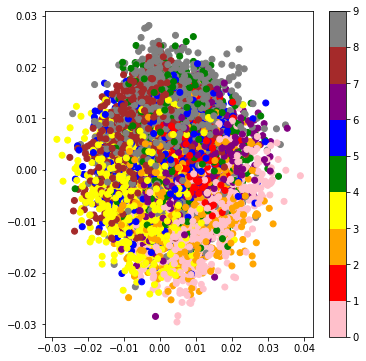

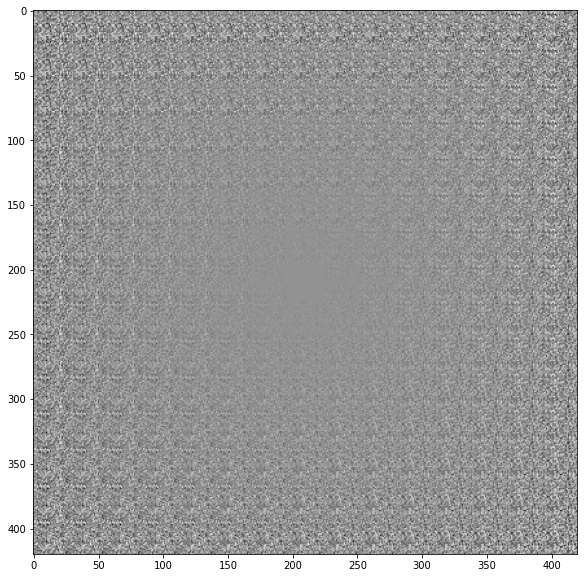

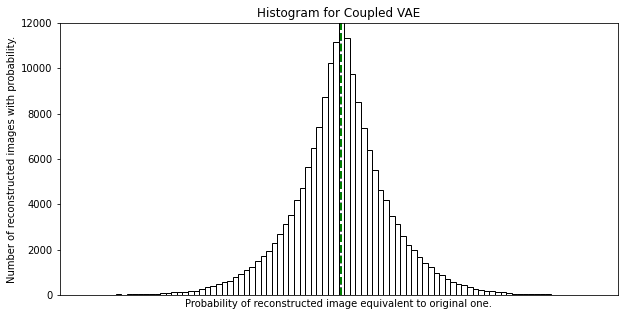

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 0.96 min

Coupling Distribution: 0, Coupling Loss: 0.025, Seed: 0


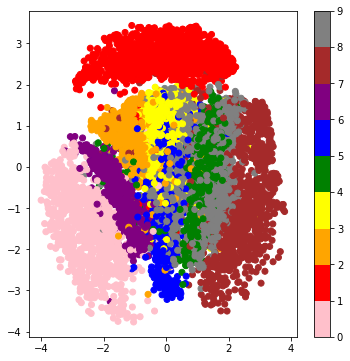

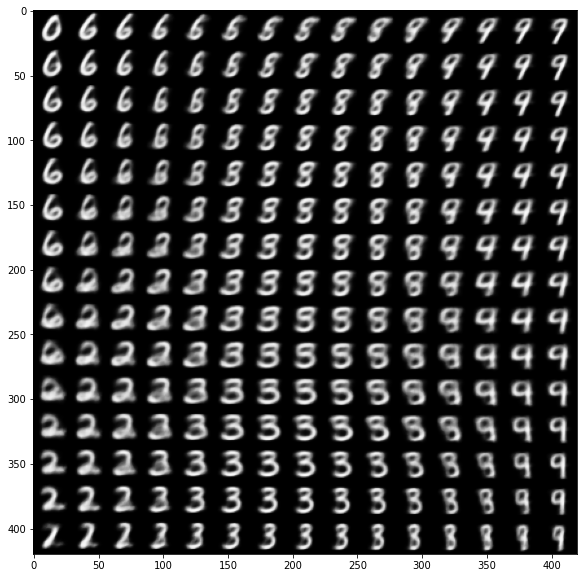

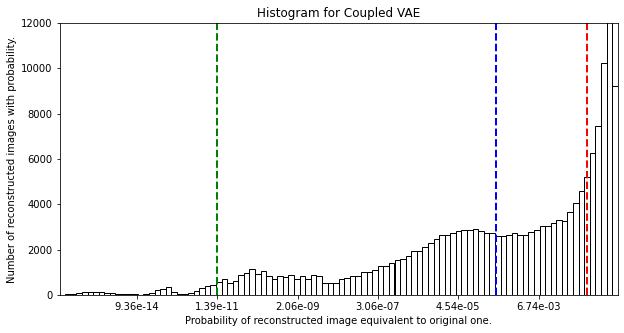

Decisiveness (Arithmetic Mean): -1.9833
Accuracy (Geometric Mean): -7.6757
Robustness (-2/3 Mean): -25.0299
Run time: 1.27 min

Coupling Distribution: 0, Coupling Loss: 0.05, Seed: 0


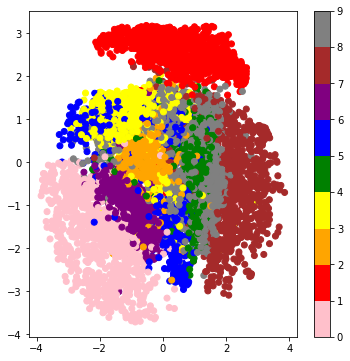

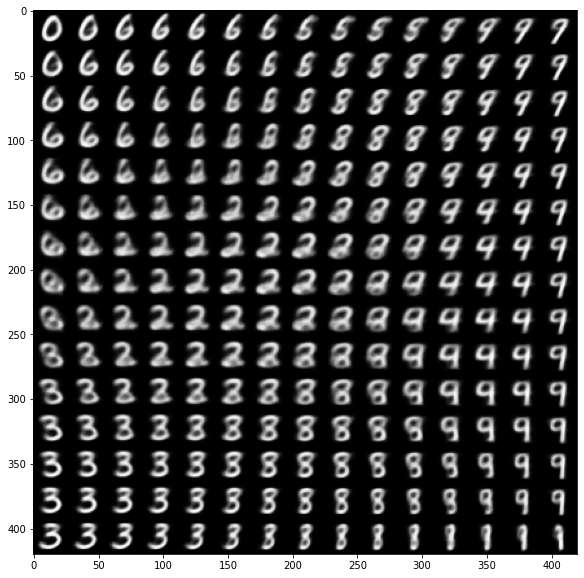

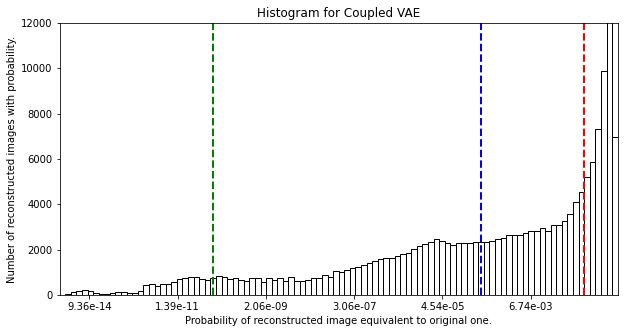

Decisiveness (Arithmetic Mean): -2.0078
Accuracy (Geometric Mean): -7.8140
Robustness (-2/3 Mean): -22.9639
Run time: 1.27 min

Coupling Distribution: 0, Coupling Loss: 0.075, Seed: 0


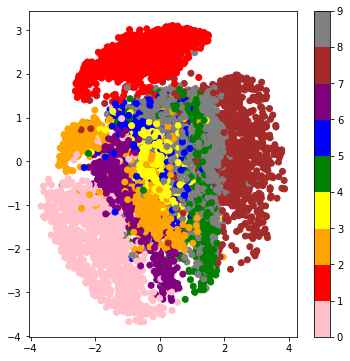

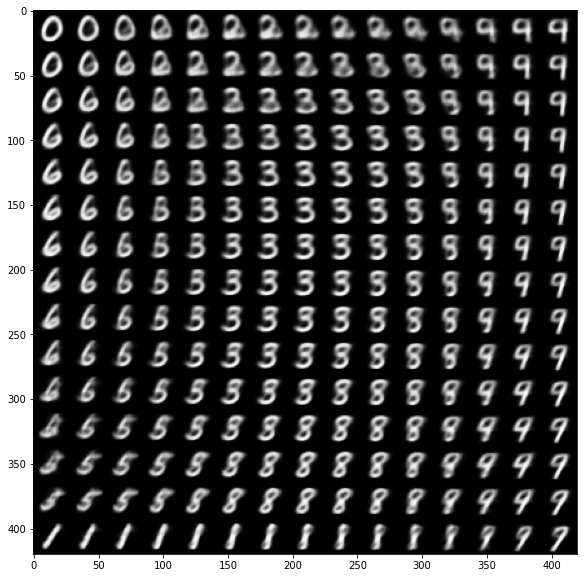

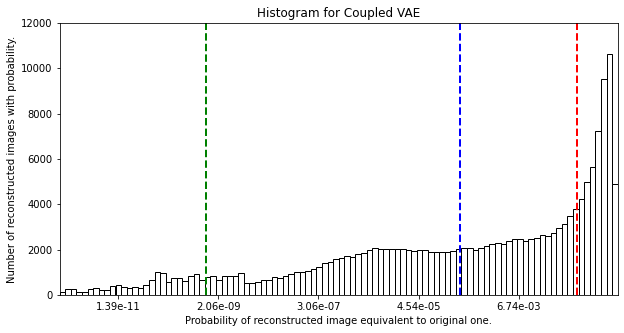

Decisiveness (Arithmetic Mean): -2.0593
Accuracy (Geometric Mean): -7.9337
Robustness (-2/3 Mean): -20.6238
Run time: 1.26 min

Coupling Distribution: 0, Coupling Loss: 0.1, Seed: 0


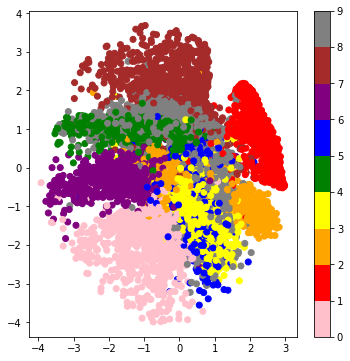

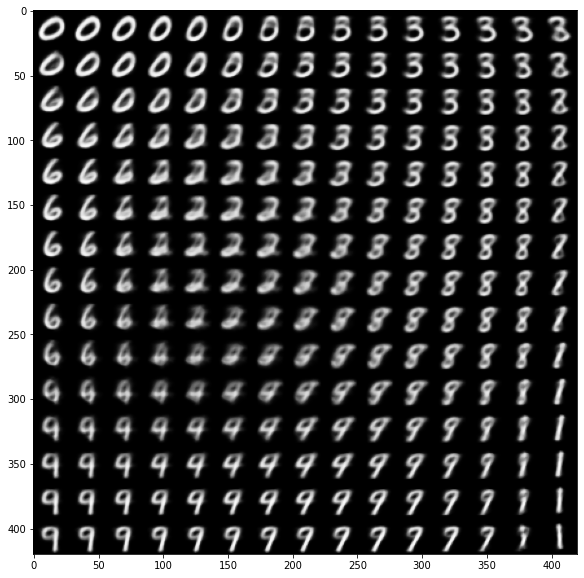

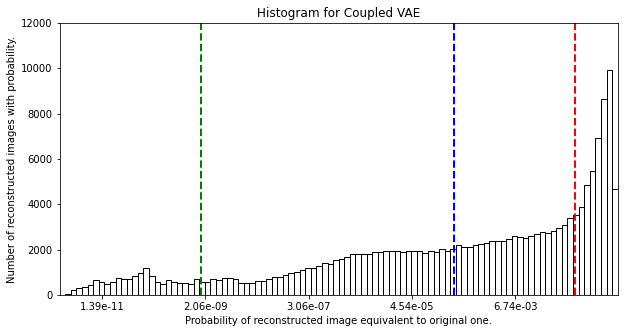

Decisiveness (Arithmetic Mean): -2.0710
Accuracy (Geometric Mean): -7.9474
Robustness (-2/3 Mean): -20.2307
Run time: 1.29 min

Coupling Distribution: 0, Coupling Loss: 0.125, Seed: 0


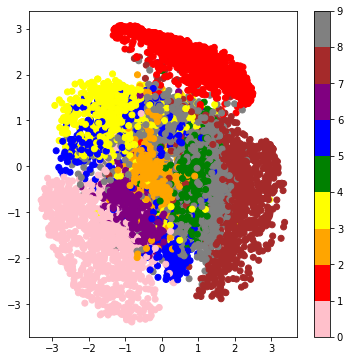

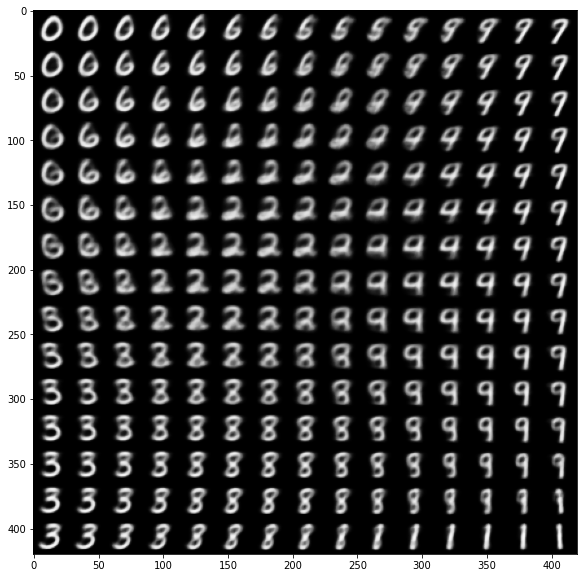

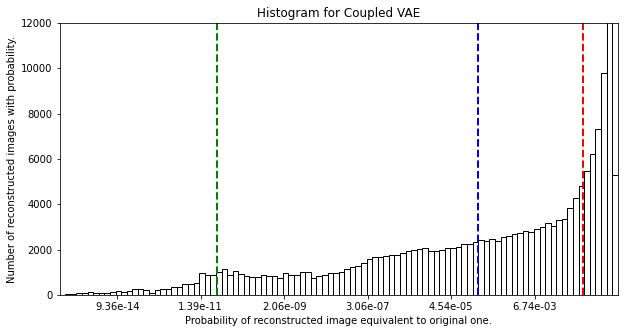

Decisiveness (Arithmetic Mean): -2.0870
Accuracy (Geometric Mean): -8.3625
Robustness (-2/3 Mean): -23.9939
Run time: 1.30 min

Coupling Distribution: 0, Coupling Loss: 0.15, Seed: 0


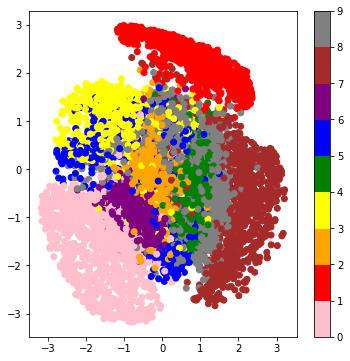

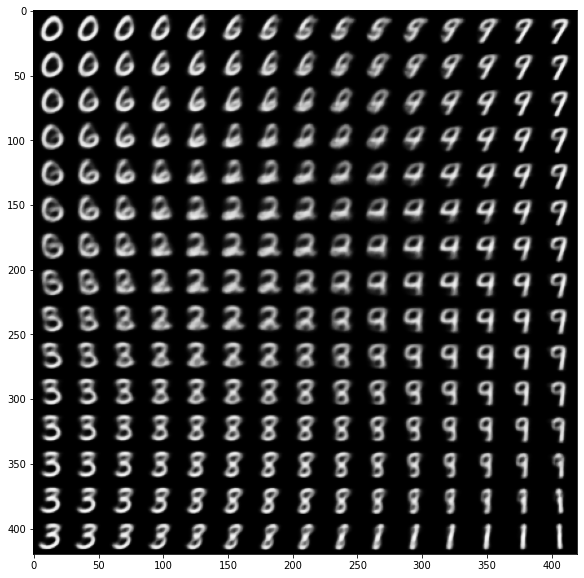

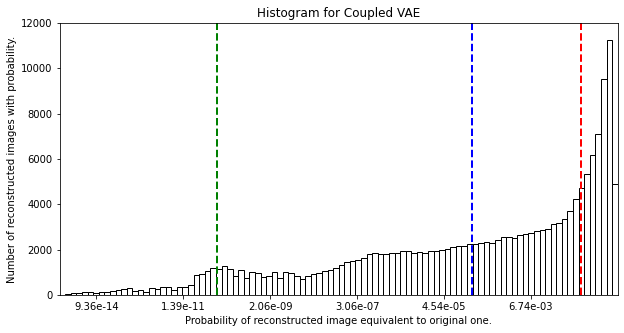

Decisiveness (Arithmetic Mean): -2.1091
Accuracy (Geometric Mean): -8.4145
Robustness (-2/3 Mean): -23.0504
Run time: 1.29 min

Coupling Distribution: 0, Coupling Loss: 0.175, Seed: 0


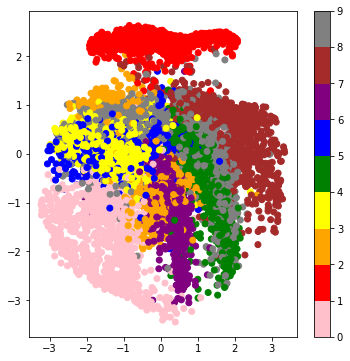

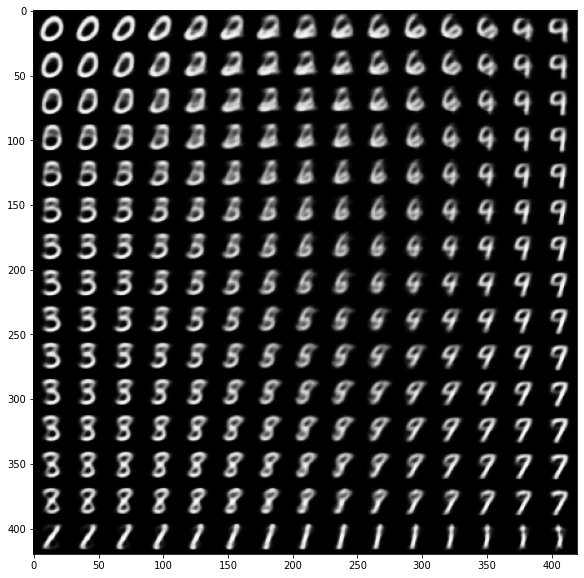

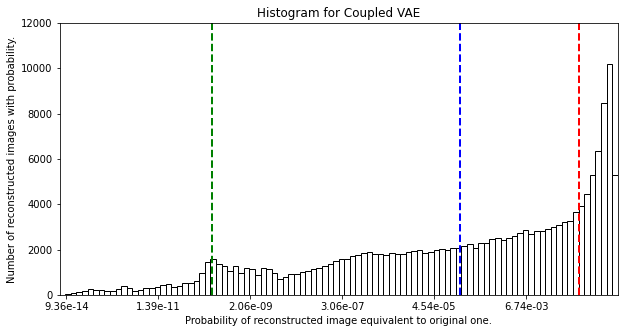

Decisiveness (Arithmetic Mean): -2.1381
Accuracy (Geometric Mean): -8.6165
Robustness (-2/3 Mean): -22.0802
Run time: 1.29 min

Coupling Distribution: 0, Coupling Loss: 0.2, Seed: 0


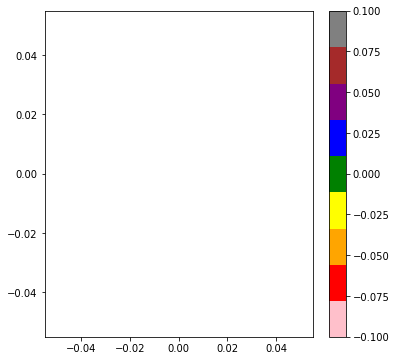

/usr/local/lib/python3.6/dist-packages/matplotlib/image.py:452: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/usr/local/lib/python3.6/dist-packages/matplotlib/image.py:459: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
/usr/local/lib/python3.6/dist-packages/matplotlib/image.py:464: UserWarning: Warning: converting a masked element to nan.
  a_max = np.float64(newmax)
<string>:6: UserWarning: Warning: converting a masked element to nan.
/usr/local/lib/python3.6/dist-packages/numpy/core/_asarray.py:85: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


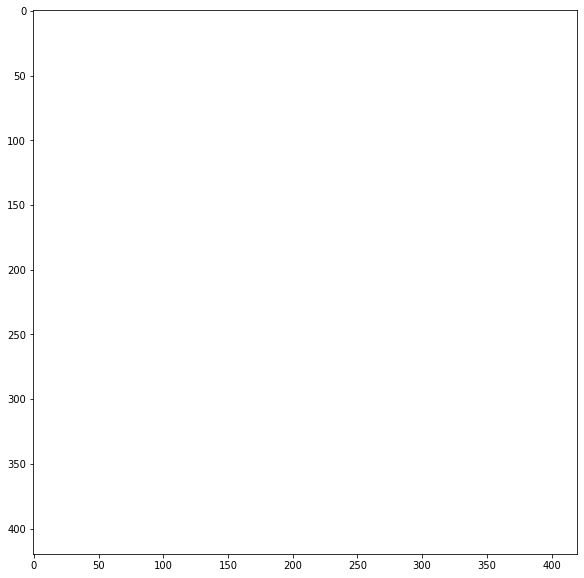

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6630: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6631: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))


Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.28 min

Coupling Distribution: 0, Coupling Loss: 0.225, Seed: 0


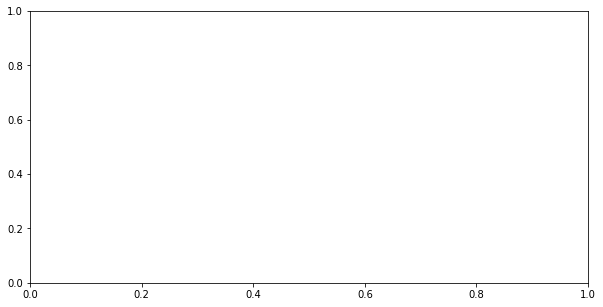

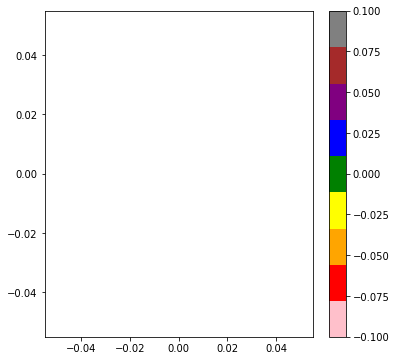

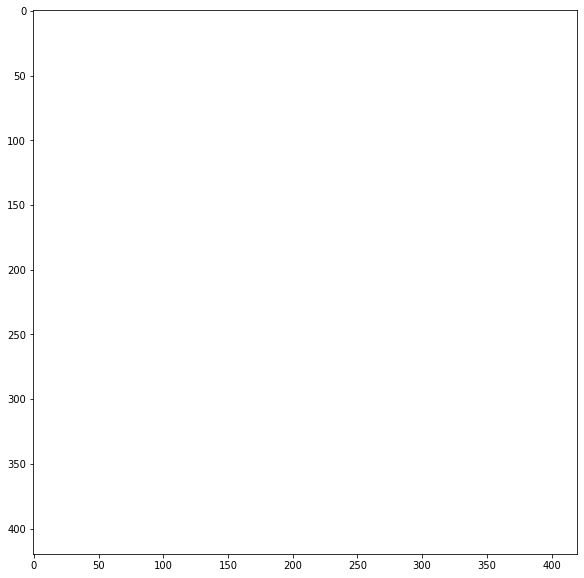

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.27 min

Coupling Distribution: 0, Coupling Loss: 0.25, Seed: 0


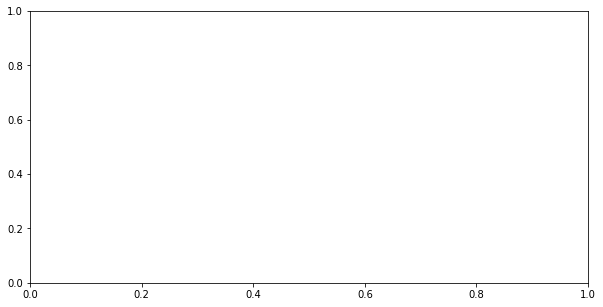

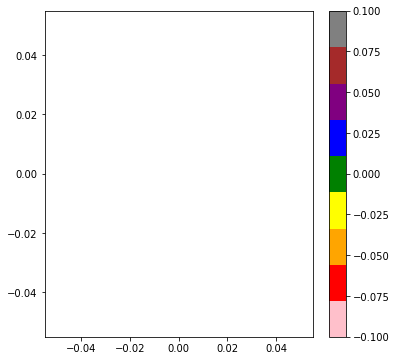

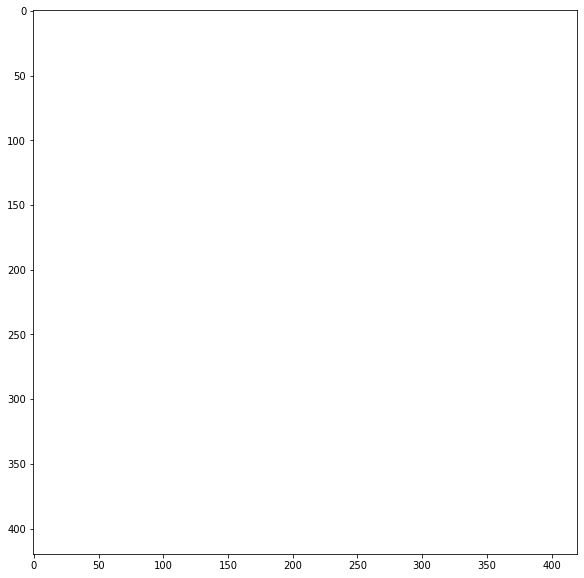

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.28 min

Coupling Distribution: 1e-06, Coupling Loss: 0, Seed: 0
Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.


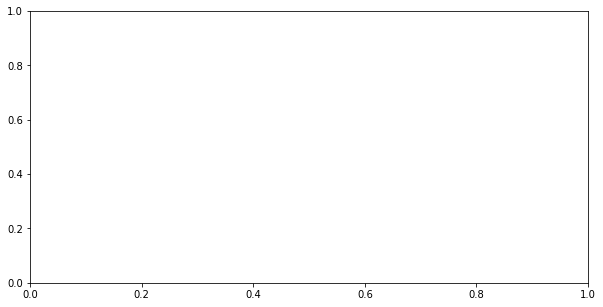

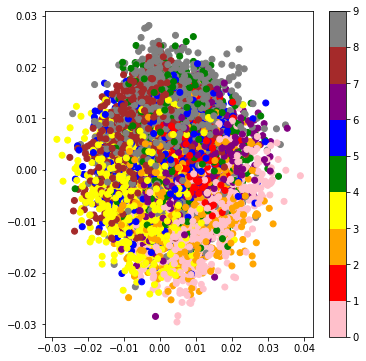

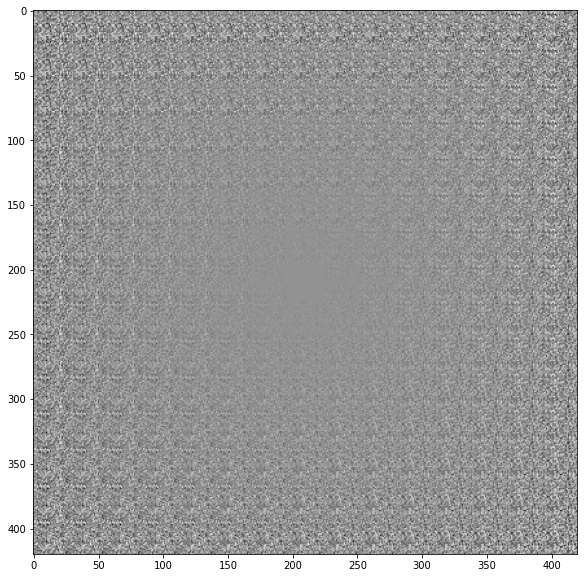

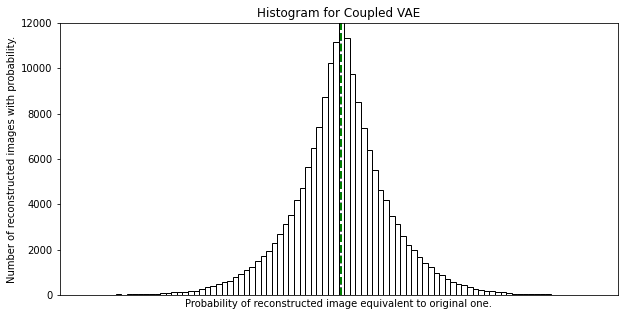

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.19 min

Coupling Distribution: 1e-06, Coupling Loss: 0.025, Seed: 0


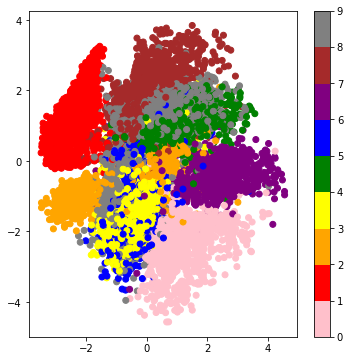

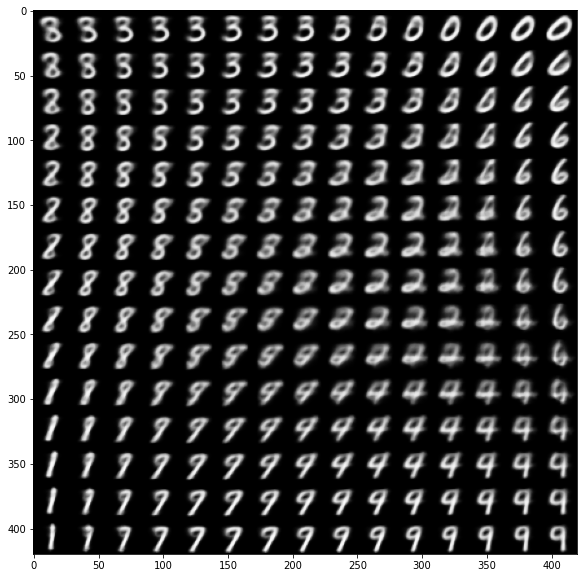

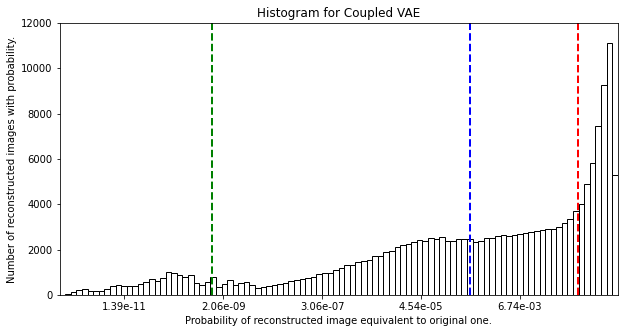

Decisiveness (Arithmetic Mean): -2.0443
Accuracy (Geometric Mean): -7.5052
Robustness (-2/3 Mean): -20.5780
Run time: 1.60 min

Coupling Distribution: 1e-06, Coupling Loss: 0.05, Seed: 0


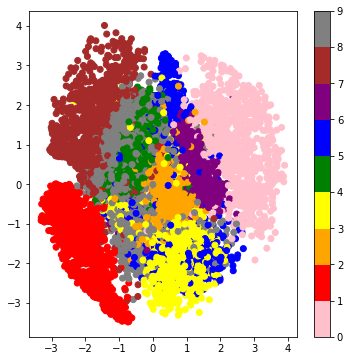

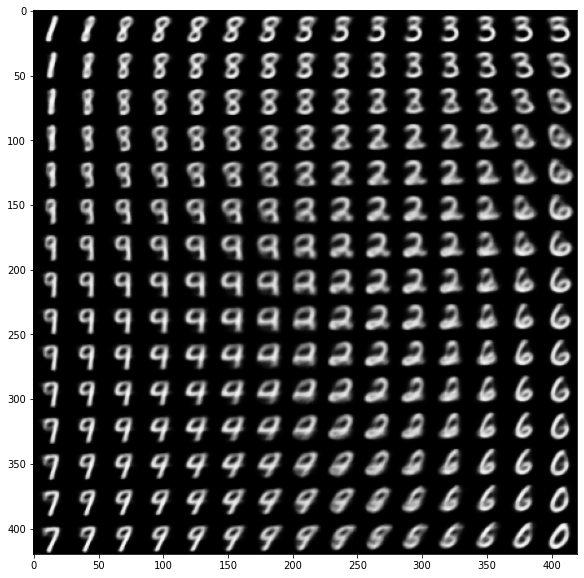

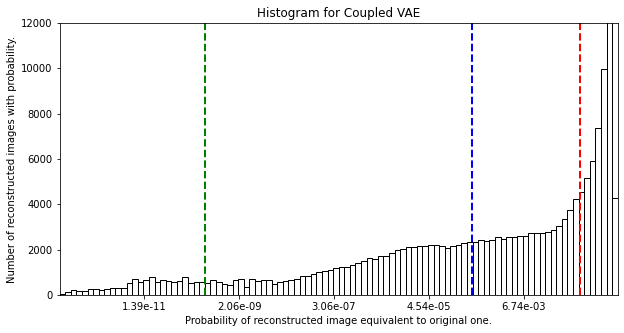

Decisiveness (Arithmetic Mean): -2.0293
Accuracy (Geometric Mean): -7.7310
Robustness (-2/3 Mean): -21.8038
Run time: 1.64 min

Coupling Distribution: 1e-06, Coupling Loss: 0.075, Seed: 0


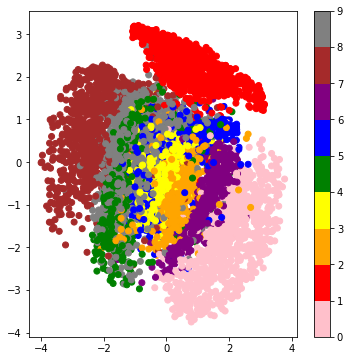

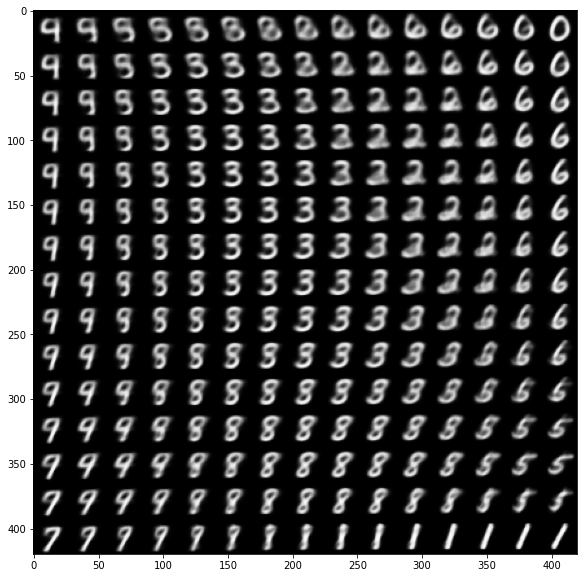

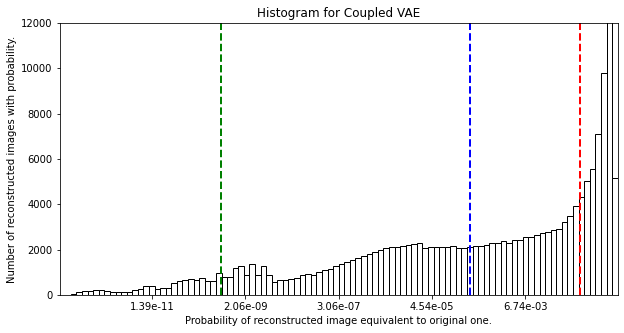

Decisiveness (Arithmetic Mean): -2.0434
Accuracy (Geometric Mean): -7.9716
Robustness (-2/3 Mean): -21.2933
Run time: 1.63 min

Coupling Distribution: 1e-06, Coupling Loss: 0.1, Seed: 0


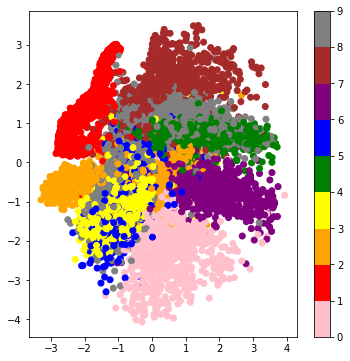

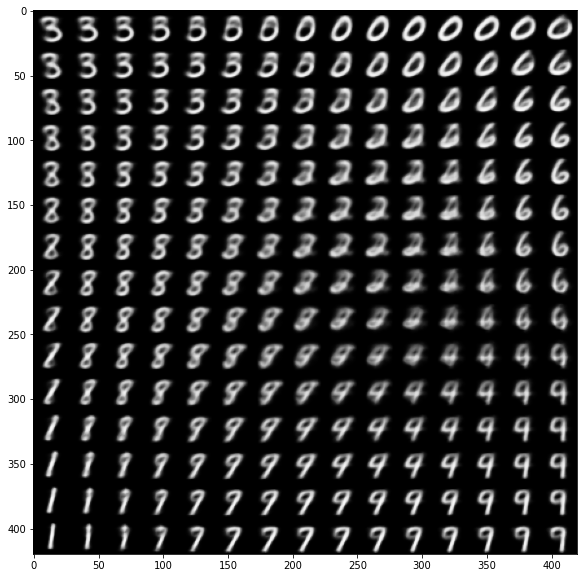

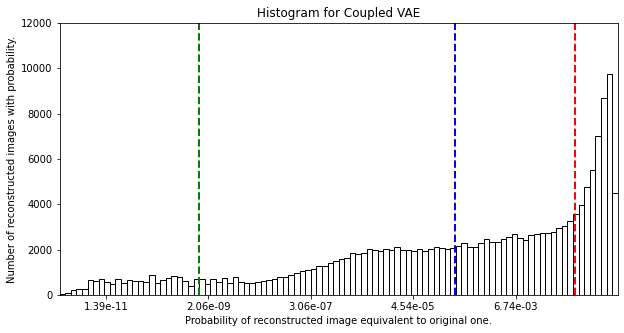

Decisiveness (Arithmetic Mean): -2.0712
Accuracy (Geometric Mean): -7.9495
Robustness (-2/3 Mean): -20.4495
Run time: 1.65 min

Coupling Distribution: 1e-06, Coupling Loss: 0.125, Seed: 0


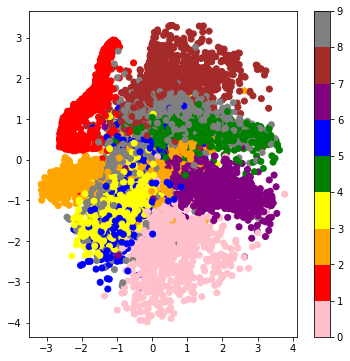

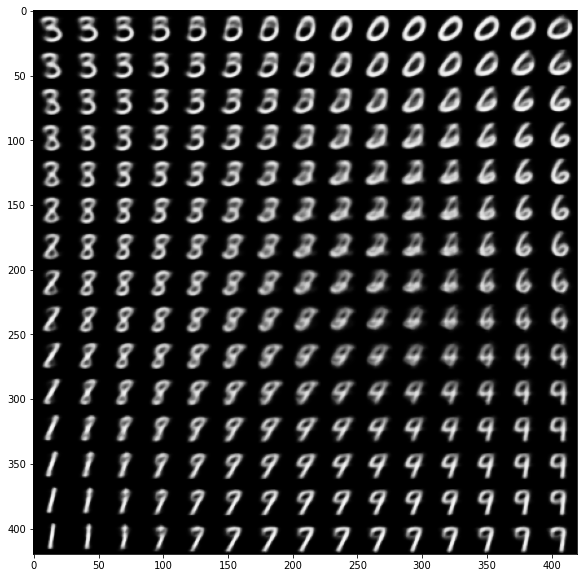

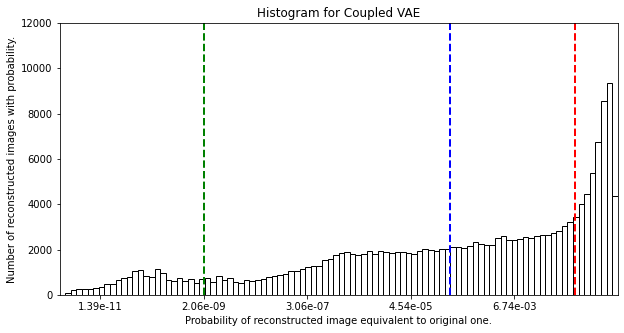

Decisiveness (Arithmetic Mean): -2.0910
Accuracy (Geometric Mean): -8.1027
Robustness (-2/3 Mean): -19.9680
Run time: 1.65 min

Coupling Distribution: 1e-06, Coupling Loss: 0.15, Seed: 0


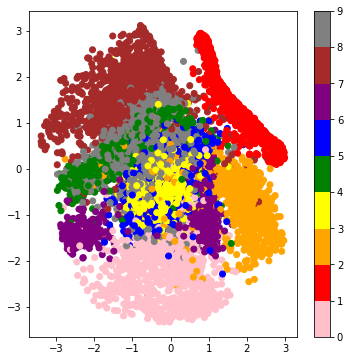

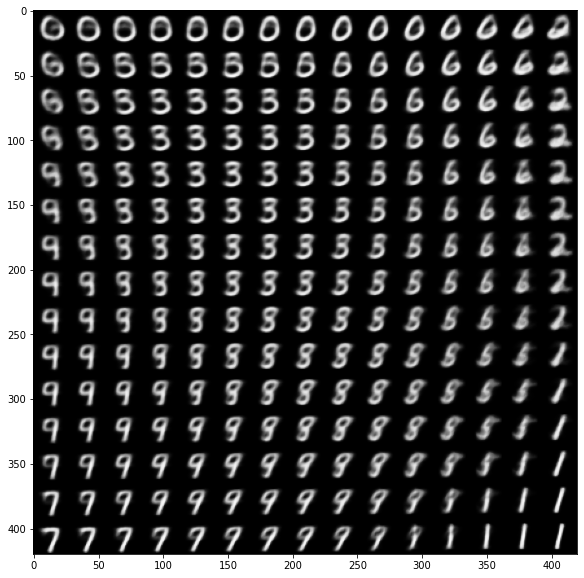

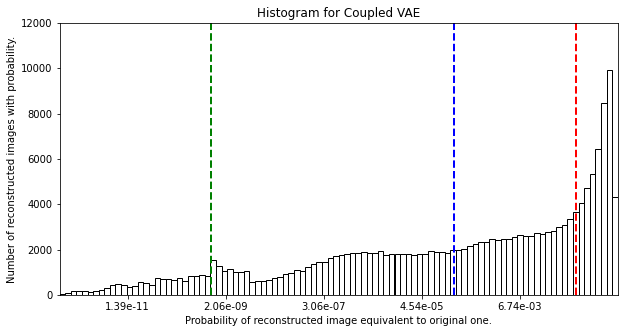

Decisiveness (Arithmetic Mean): -2.1180
Accuracy (Geometric Mean): -8.3523
Robustness (-2/3 Mean): -20.7652
Run time: 1.63 min

Coupling Distribution: 1e-06, Coupling Loss: 0.175, Seed: 0


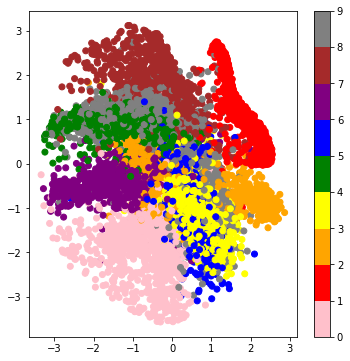

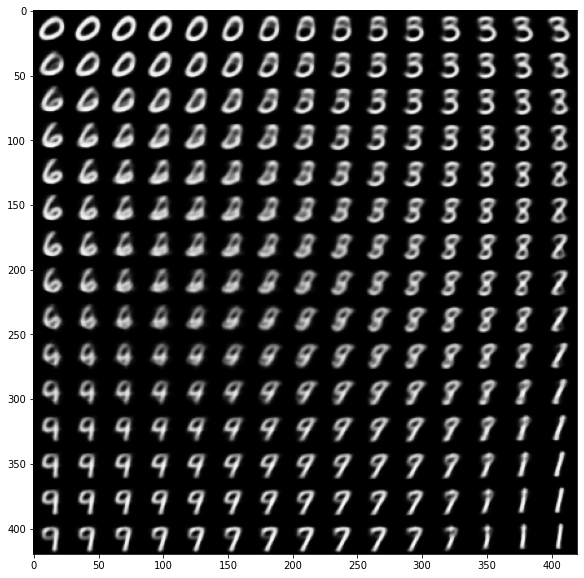

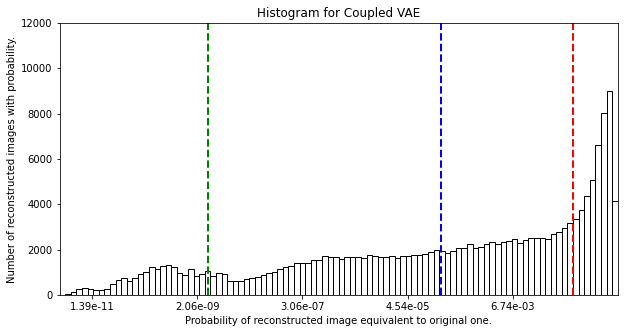

Decisiveness (Arithmetic Mean): -2.1182
Accuracy (Geometric Mean): -8.4076
Robustness (-2/3 Mean): -19.4845
Run time: 1.64 min

Coupling Distribution: 1e-06, Coupling Loss: 0.2, Seed: 0


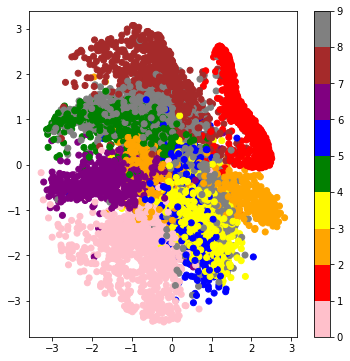

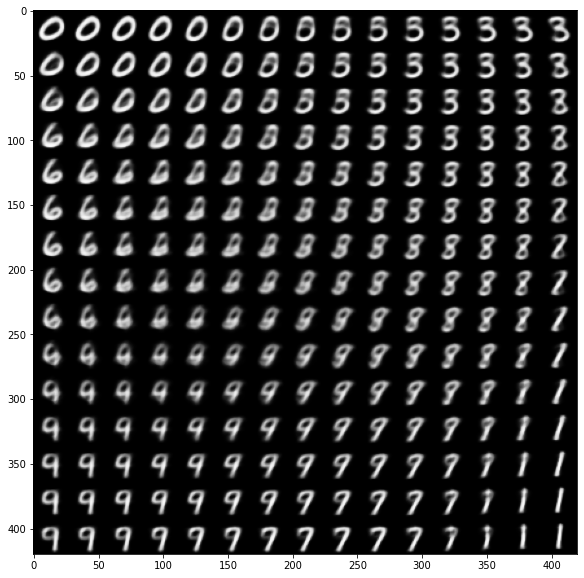

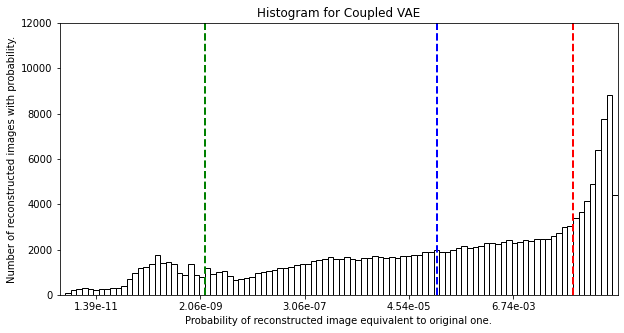

Decisiveness (Arithmetic Mean): -2.1358
Accuracy (Geometric Mean): -8.6543
Robustness (-2/3 Mean): -19.7481
Run time: 1.63 min

Coupling Distribution: 1e-06, Coupling Loss: 0.225, Seed: 0


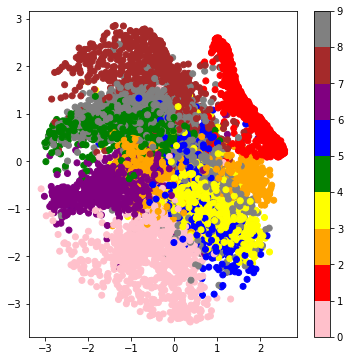

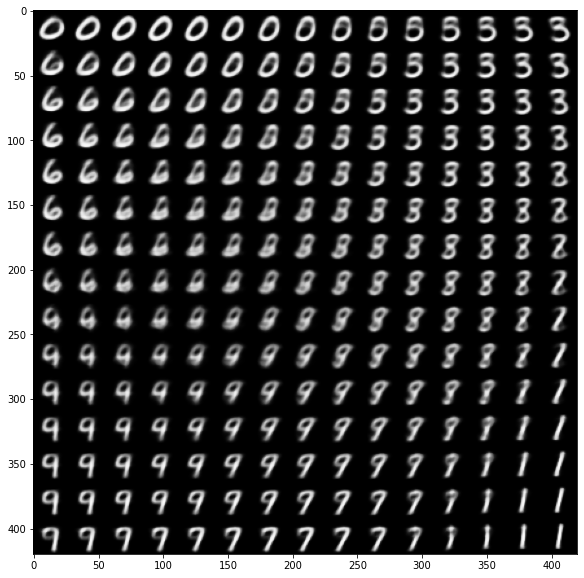

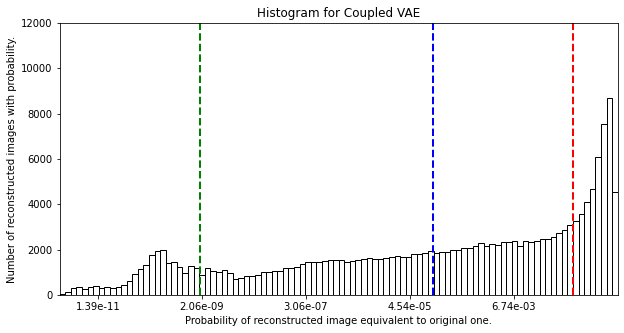

Decisiveness (Arithmetic Mean): -2.1518
Accuracy (Geometric Mean): -8.9045
Robustness (-2/3 Mean): -20.0751
Run time: 1.65 min

Coupling Distribution: 1e-06, Coupling Loss: 0.25, Seed: 0


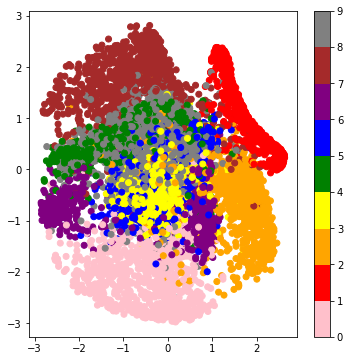

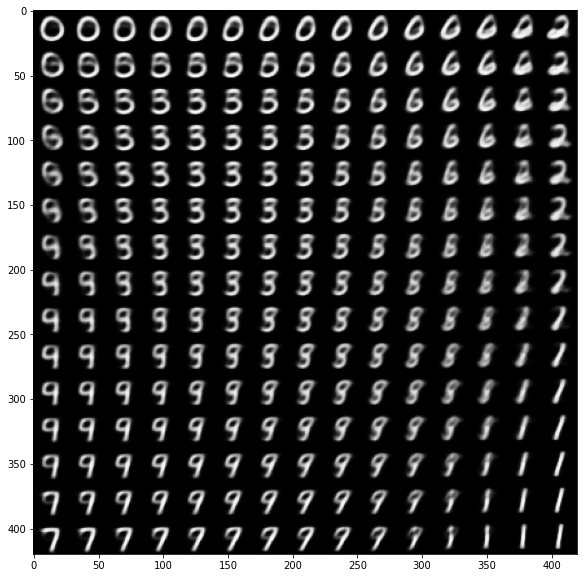

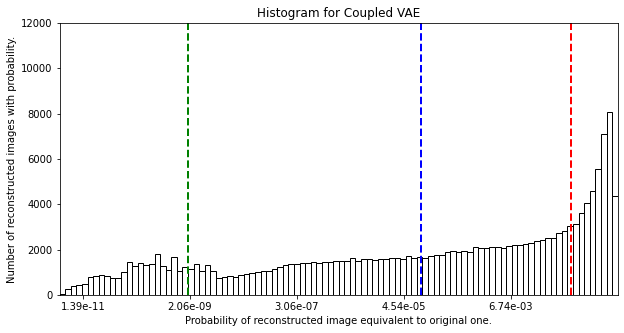

Decisiveness (Arithmetic Mean): -2.1848
Accuracy (Geometric Mean): -9.1899
Robustness (-2/3 Mean): -20.1042
Run time: 1.66 min

Coupling Distribution: 1e-05, Coupling Loss: 0, Seed: 0


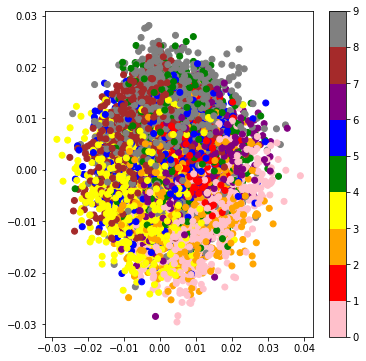

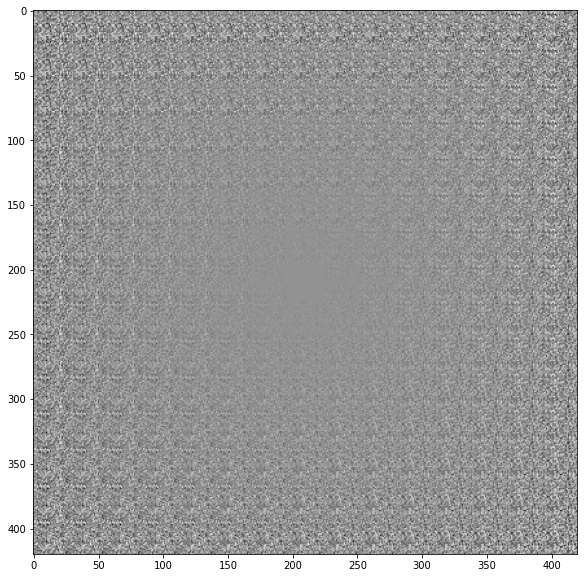

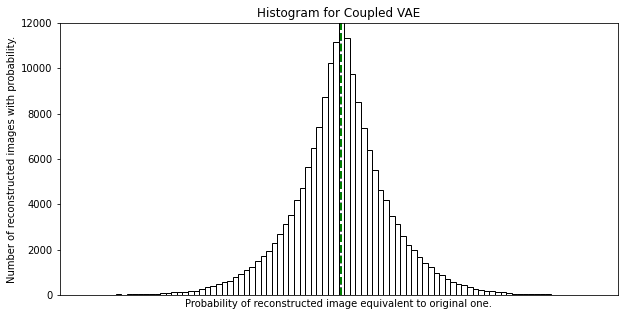

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.19 min

Coupling Distribution: 1e-05, Coupling Loss: 0.025, Seed: 0


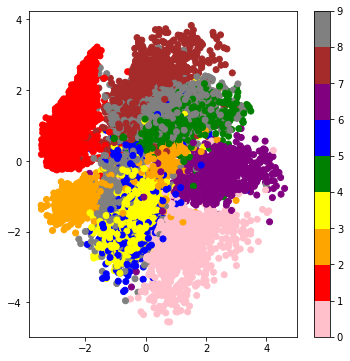

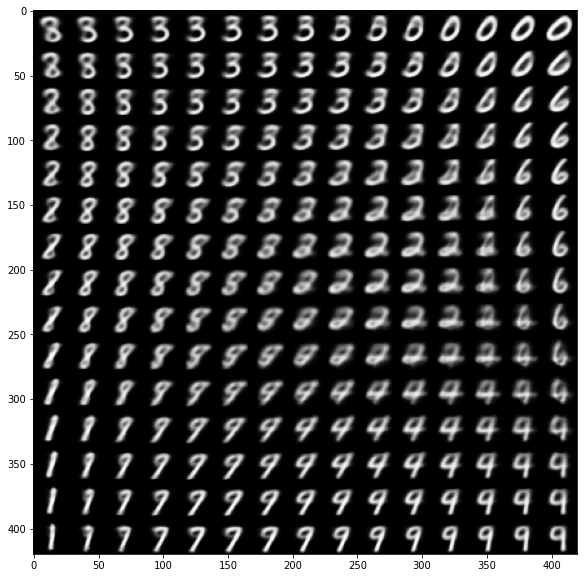

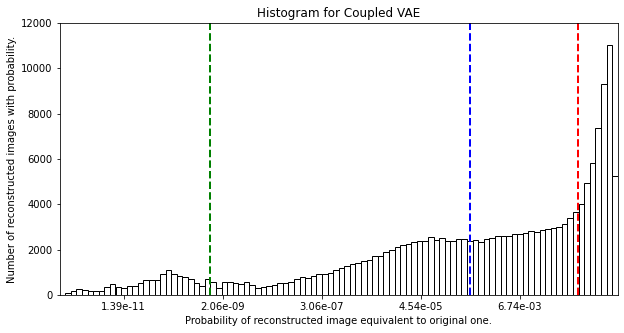

Decisiveness (Arithmetic Mean): -2.0449
Accuracy (Geometric Mean): -7.5189
Robustness (-2/3 Mean): -20.6319
Run time: 1.62 min

Coupling Distribution: 1e-05, Coupling Loss: 0.05, Seed: 0


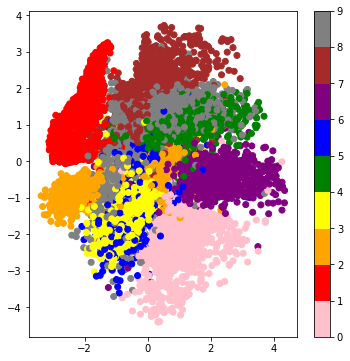

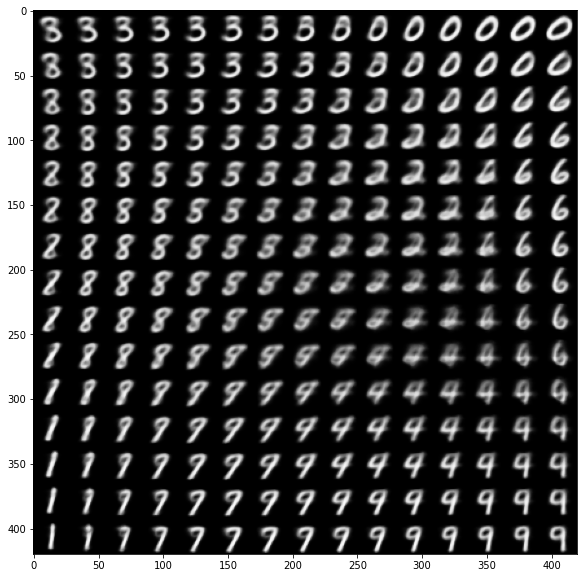

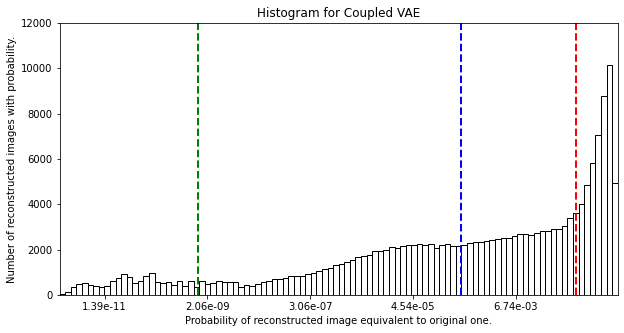

Decisiveness (Arithmetic Mean): -2.0520
Accuracy (Geometric Mean): -7.6709
Robustness (-2/3 Mean): -20.4801
Run time: 1.66 min

Coupling Distribution: 1e-05, Coupling Loss: 0.075, Seed: 0


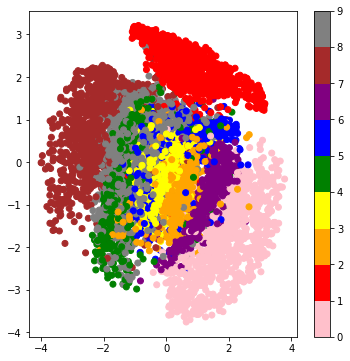

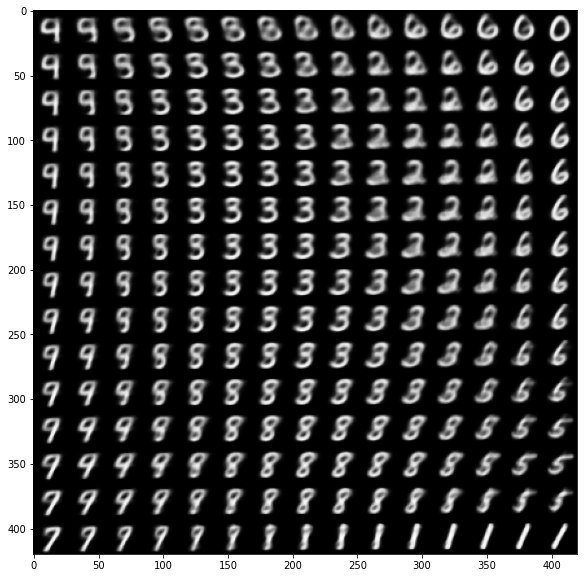

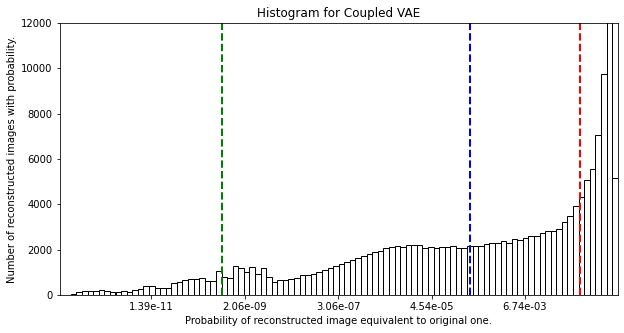

Decisiveness (Arithmetic Mean): -2.0428
Accuracy (Geometric Mean): -7.9600
Robustness (-2/3 Mean): -21.2312
Run time: 1.63 min

Coupling Distribution: 1e-05, Coupling Loss: 0.1, Seed: 0


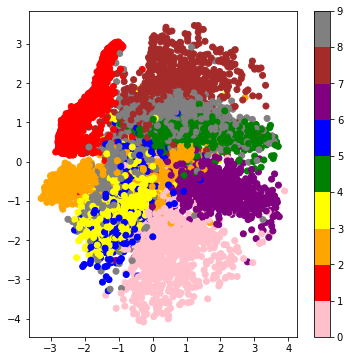

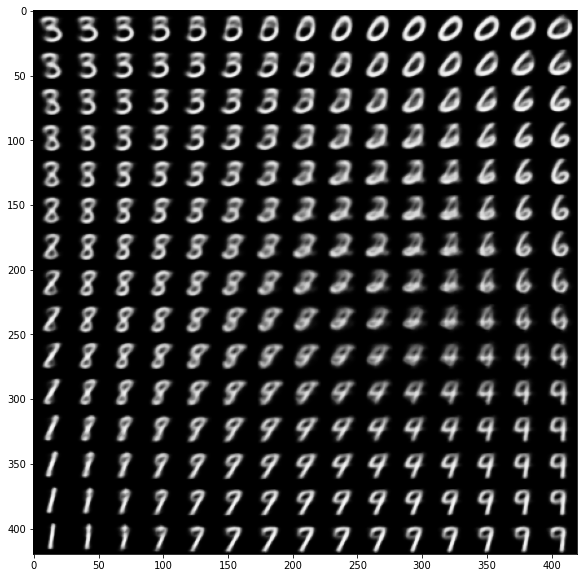

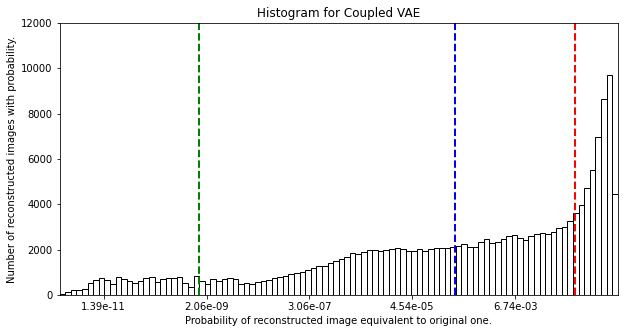

Decisiveness (Arithmetic Mean): -2.0724
Accuracy (Geometric Mean): -7.9403
Robustness (-2/3 Mean): -20.3522
Run time: 1.62 min

Coupling Distribution: 1e-05, Coupling Loss: 0.125, Seed: 0


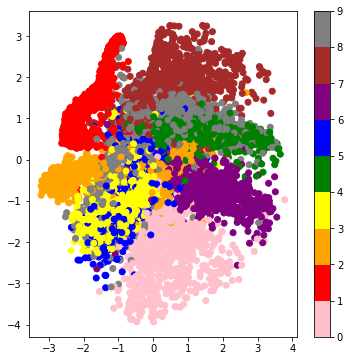

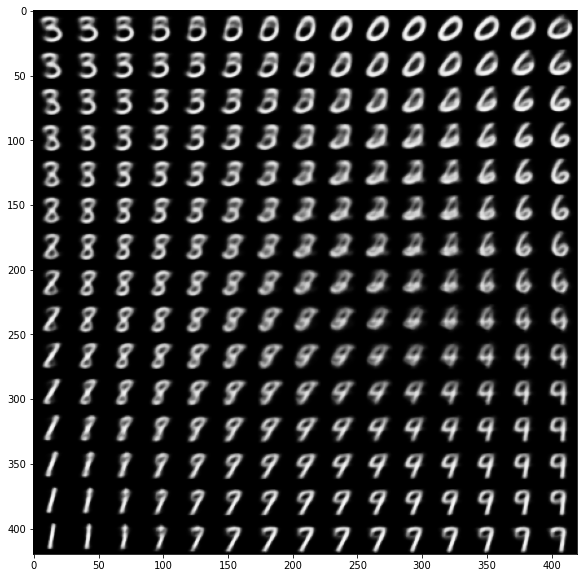

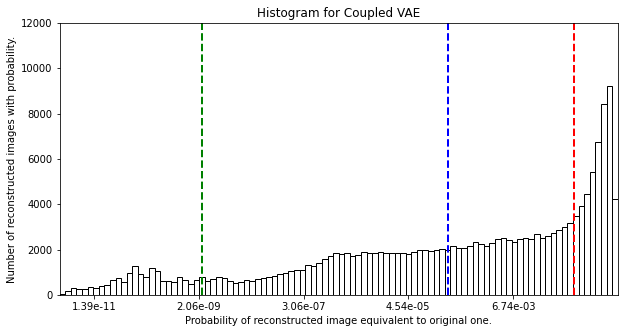

Decisiveness (Arithmetic Mean): -2.0915
Accuracy (Geometric Mean): -8.0920
Robustness (-2/3 Mean): -19.8617
Run time: 1.63 min

Coupling Distribution: 1e-05, Coupling Loss: 0.15, Seed: 0


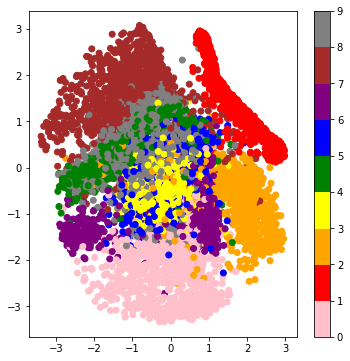

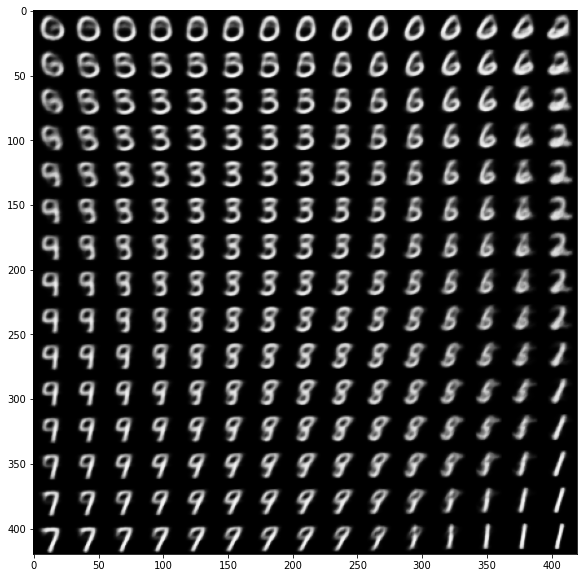

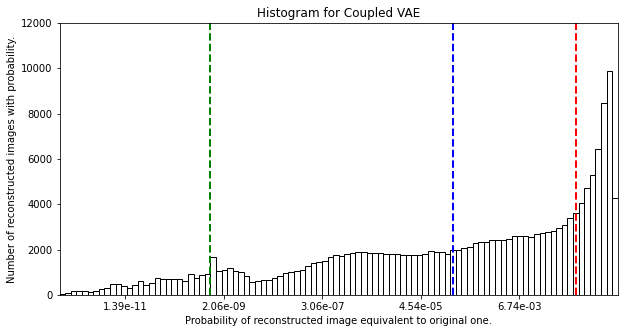

Decisiveness (Arithmetic Mean): -2.1177
Accuracy (Geometric Mean): -8.3456
Robustness (-2/3 Mean): -20.6993
Run time: 1.63 min

Coupling Distribution: 1e-05, Coupling Loss: 0.175, Seed: 0


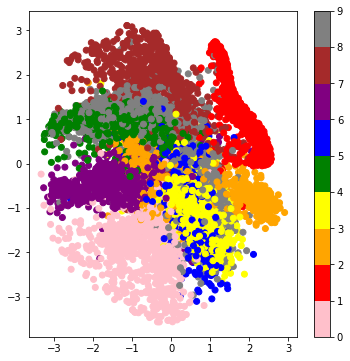

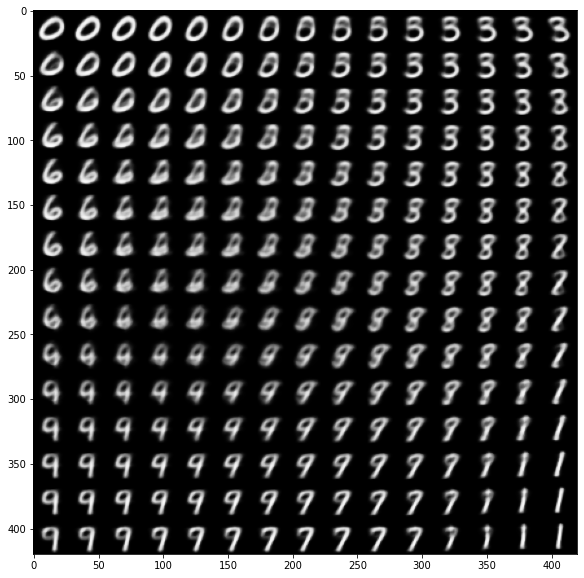

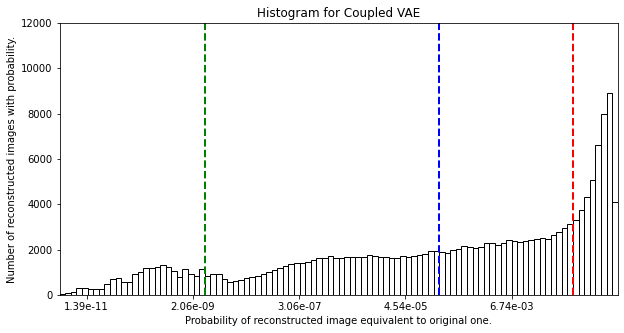

Decisiveness (Arithmetic Mean): -2.1179
Accuracy (Geometric Mean): -8.4075
Robustness (-2/3 Mean): -19.4132
Run time: 1.62 min

Coupling Distribution: 1e-05, Coupling Loss: 0.2, Seed: 0


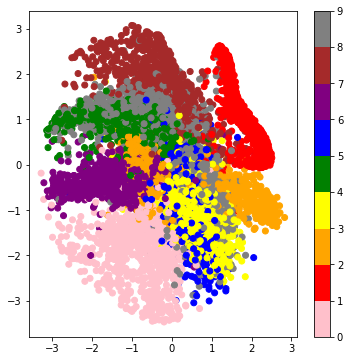

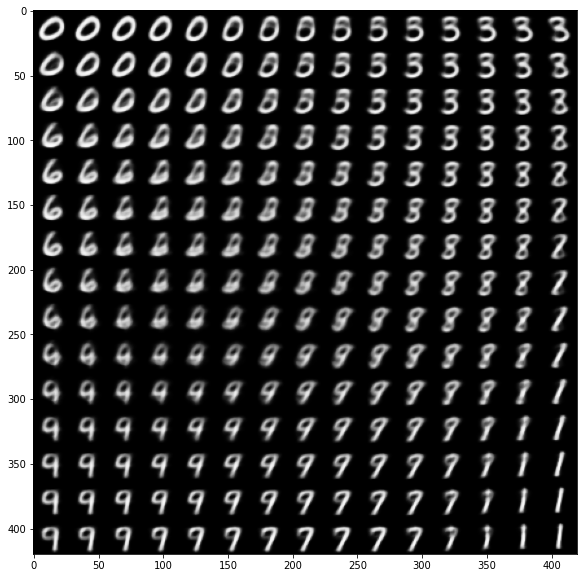

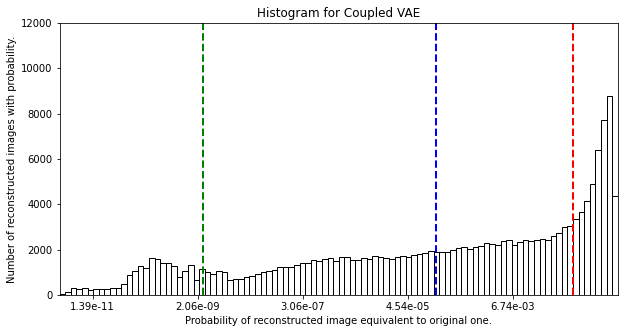

Decisiveness (Arithmetic Mean): -2.1355
Accuracy (Geometric Mean): -8.6556
Robustness (-2/3 Mean): -19.7381
Run time: 1.67 min

Coupling Distribution: 1e-05, Coupling Loss: 0.225, Seed: 0


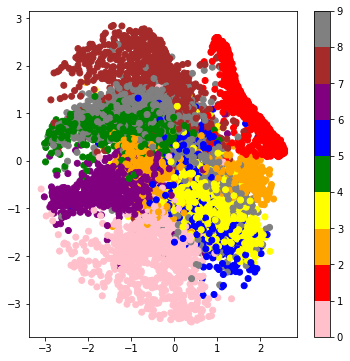

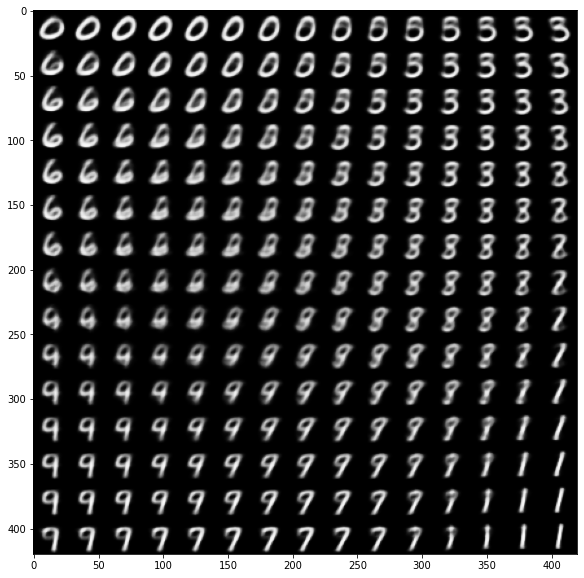

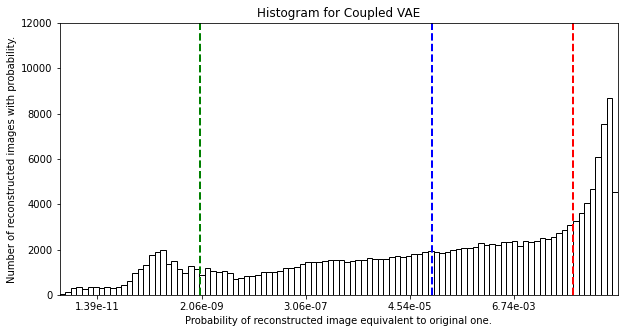

Decisiveness (Arithmetic Mean): -2.1517
Accuracy (Geometric Mean): -8.9045
Robustness (-2/3 Mean): -20.0660
Run time: 1.66 min

Coupling Distribution: 1e-05, Coupling Loss: 0.25, Seed: 0


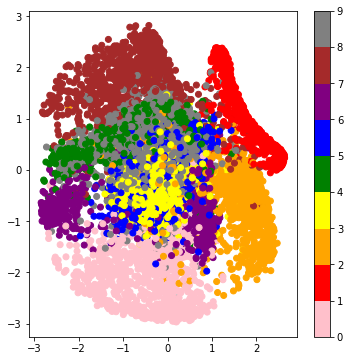

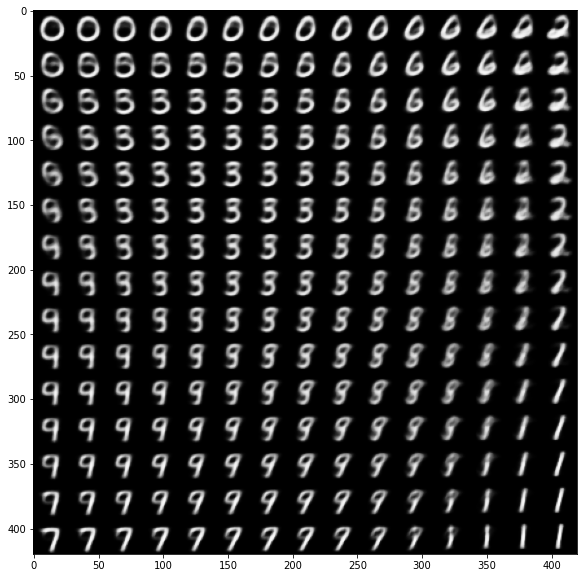

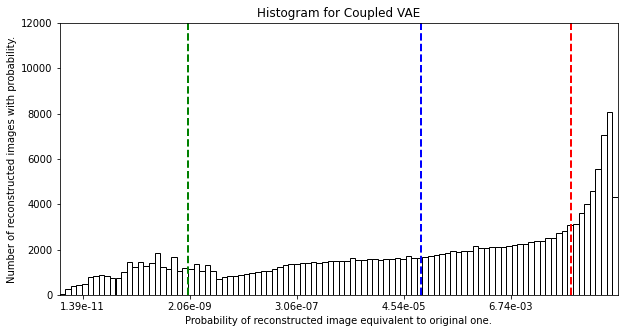

Decisiveness (Arithmetic Mean): -2.1849
Accuracy (Geometric Mean): -9.1856
Robustness (-2/3 Mean): -20.0913
Run time: 1.64 min

Coupling Distribution: 0.0001, Coupling Loss: 0, Seed: 0


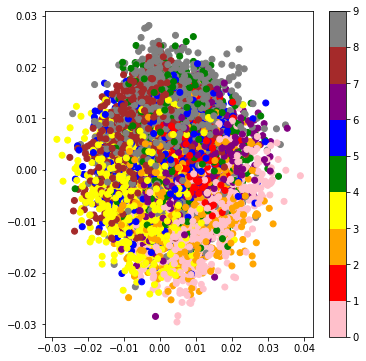

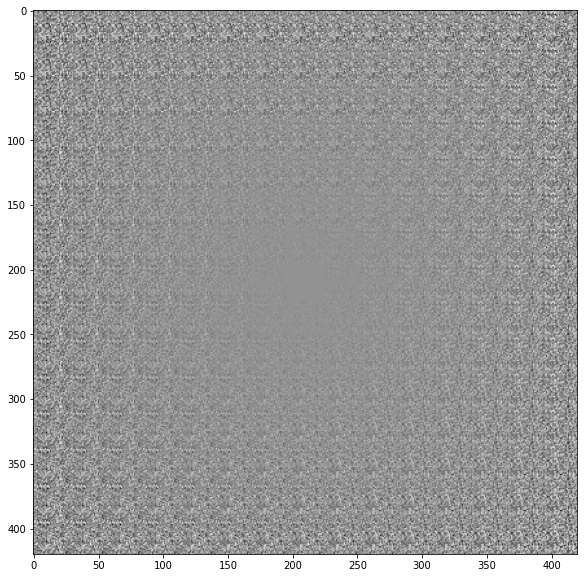

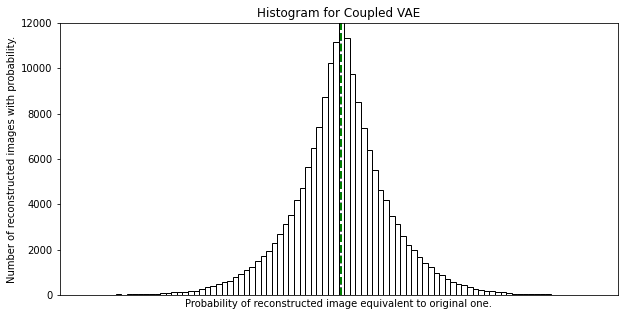

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.18 min

Coupling Distribution: 0.0001, Coupling Loss: 0.025, Seed: 0


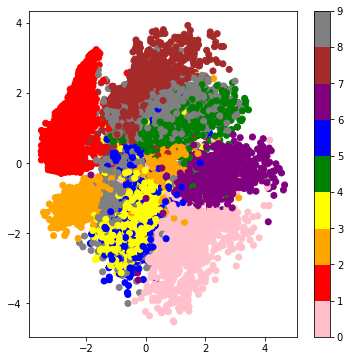

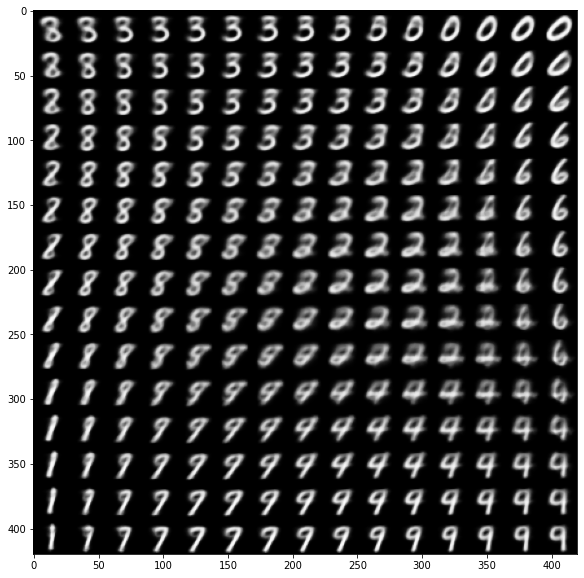

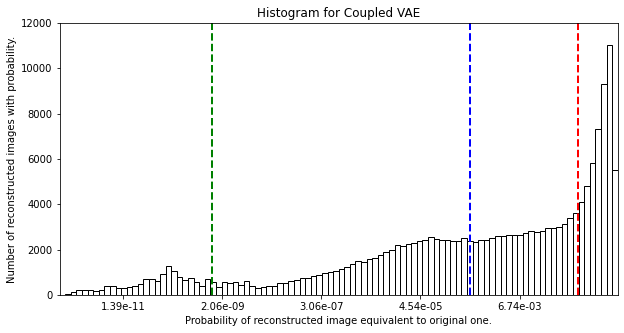

Decisiveness (Arithmetic Mean): -2.0439
Accuracy (Geometric Mean): -7.5052
Robustness (-2/3 Mean): -20.5108
Run time: 1.62 min

Coupling Distribution: 0.0001, Coupling Loss: 0.05, Seed: 0


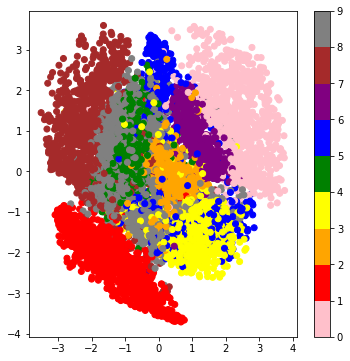

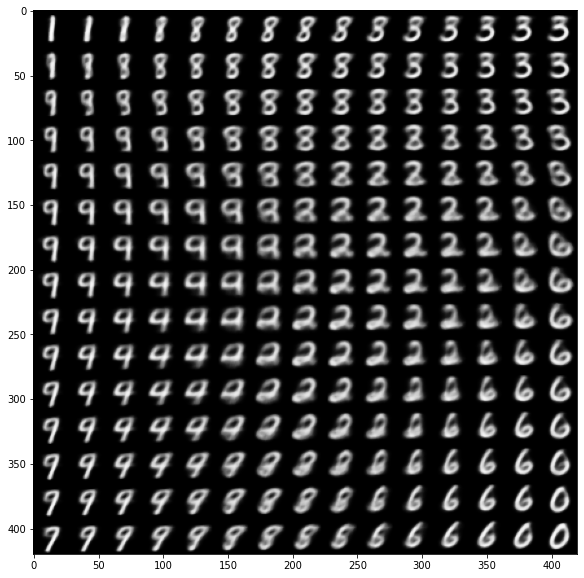

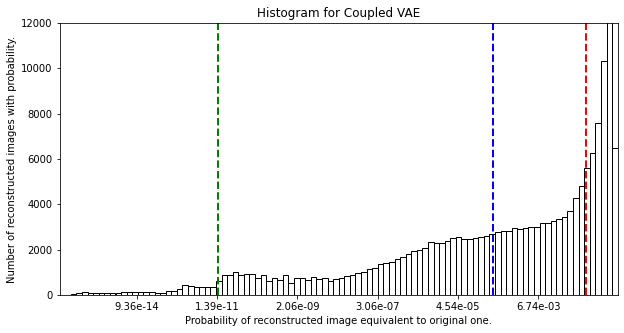

Decisiveness (Arithmetic Mean): -2.0171
Accuracy (Geometric Mean): -7.8219
Robustness (-2/3 Mean): -24.9662
Run time: 1.66 min

Coupling Distribution: 0.0001, Coupling Loss: 0.075, Seed: 0


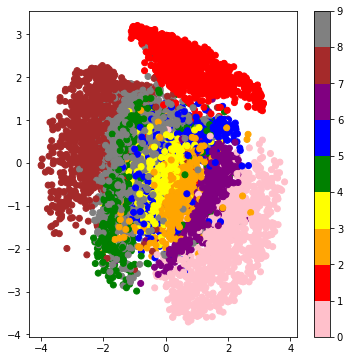

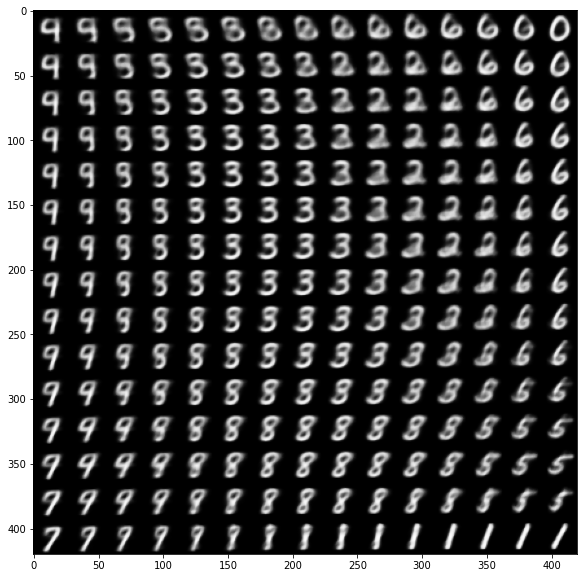

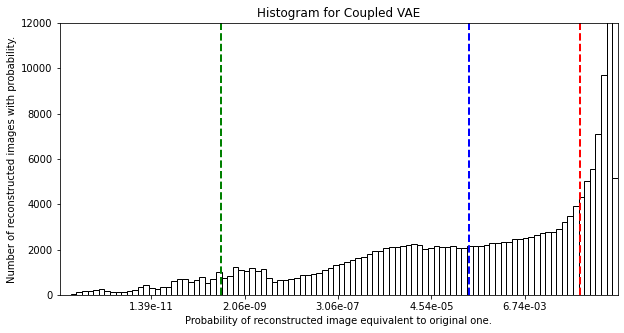

Decisiveness (Arithmetic Mean): -2.0422
Accuracy (Geometric Mean): -7.9667
Robustness (-2/3 Mean): -21.2409
Run time: 1.61 min

Coupling Distribution: 0.0001, Coupling Loss: 0.1, Seed: 0


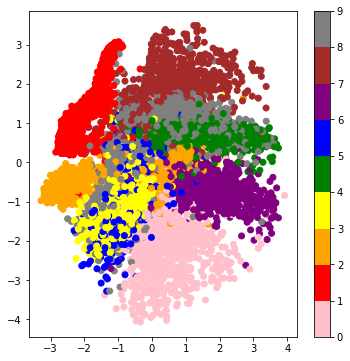

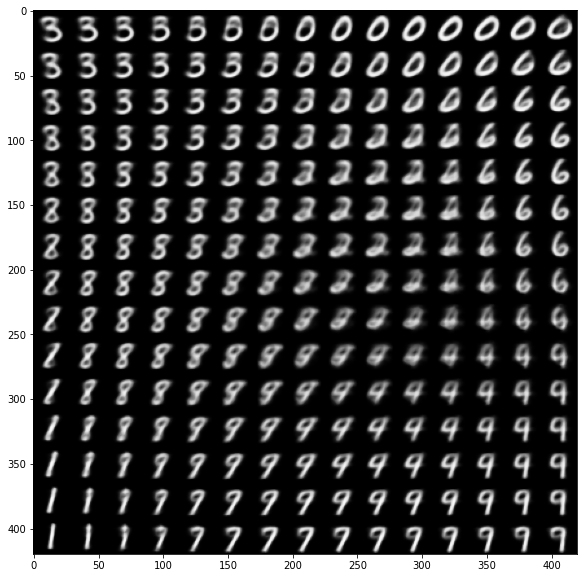

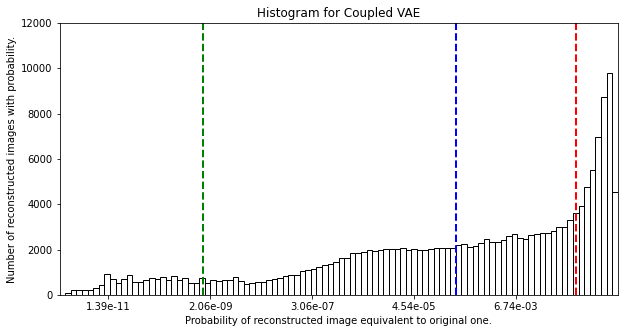

Decisiveness (Arithmetic Mean): -2.0718
Accuracy (Geometric Mean): -7.9357
Robustness (-2/3 Mean): -20.3246
Run time: 1.63 min

Coupling Distribution: 0.0001, Coupling Loss: 0.125, Seed: 0


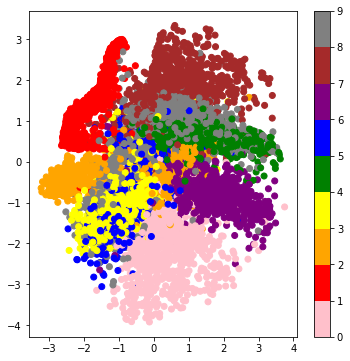

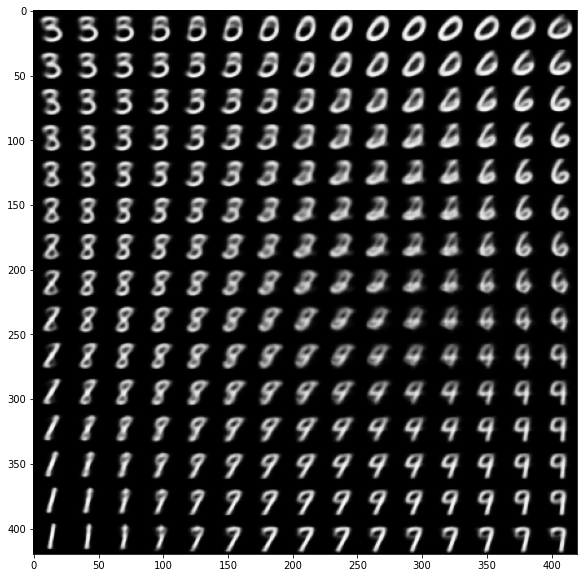

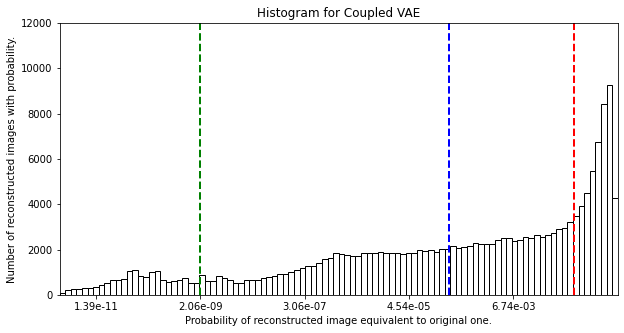

Decisiveness (Arithmetic Mean): -2.0906
Accuracy (Geometric Mean): -8.1026
Robustness (-2/3 Mean): -20.0073
Run time: 1.63 min

Coupling Distribution: 0.0001, Coupling Loss: 0.15, Seed: 0


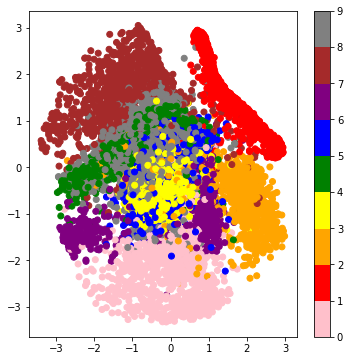

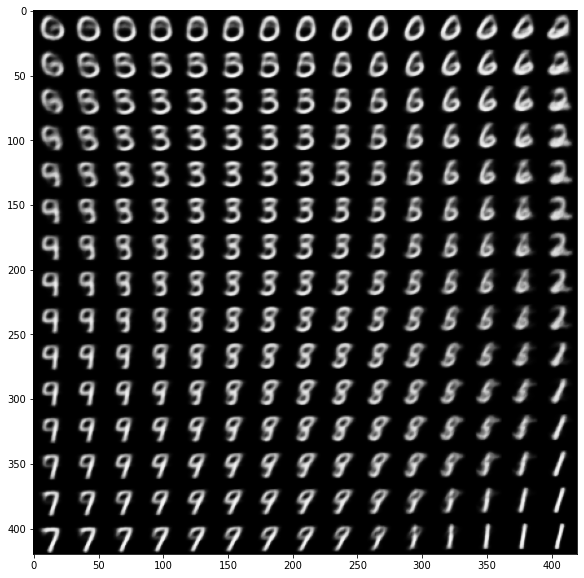

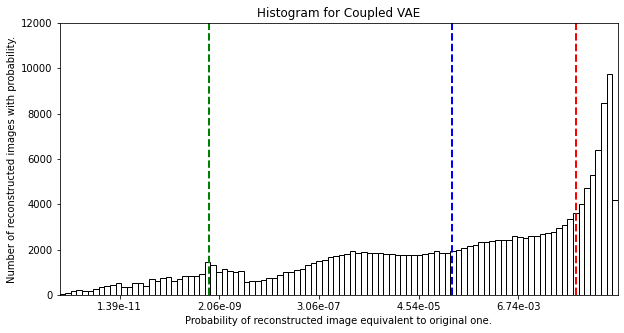

Decisiveness (Arithmetic Mean): -2.1170
Accuracy (Geometric Mean): -8.3279
Robustness (-2/3 Mean): -20.5055
Run time: 1.62 min

Coupling Distribution: 0.0001, Coupling Loss: 0.175, Seed: 0


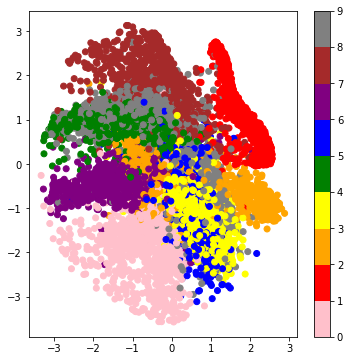

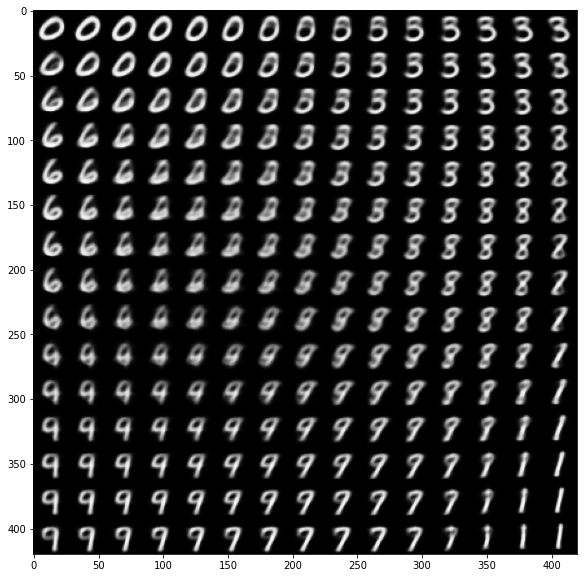

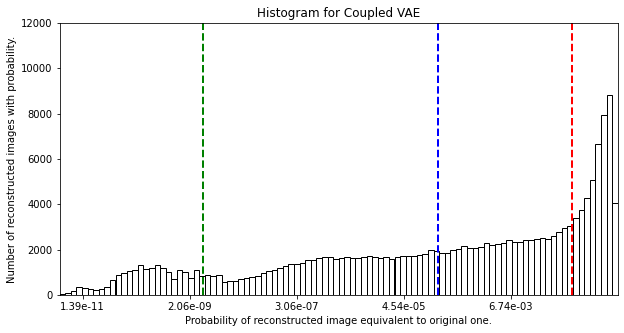

Decisiveness (Arithmetic Mean): -2.1182
Accuracy (Geometric Mean): -8.4162
Robustness (-2/3 Mean): -19.3666
Run time: 1.67 min

Coupling Distribution: 0.0001, Coupling Loss: 0.2, Seed: 0


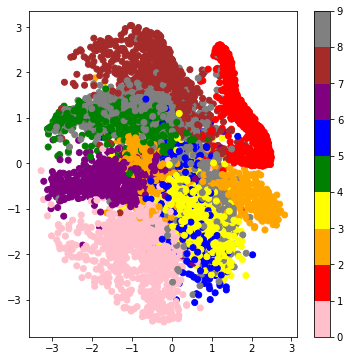

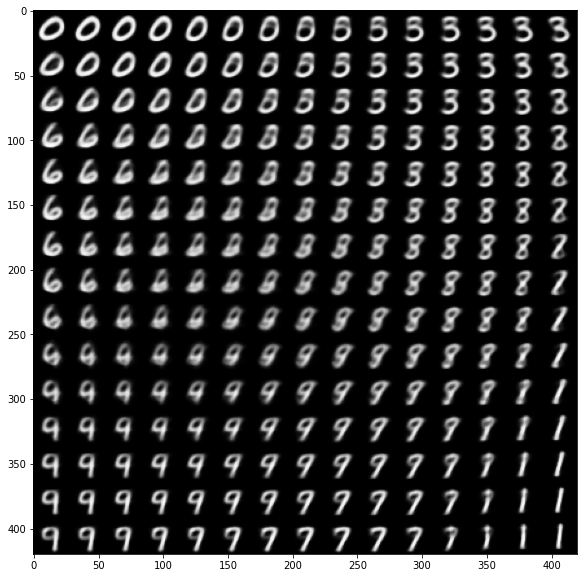

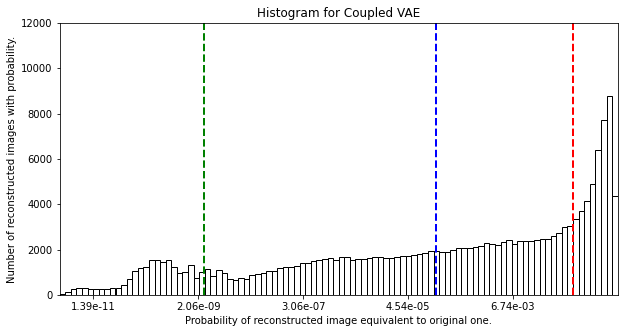

Decisiveness (Arithmetic Mean): -2.1356
Accuracy (Geometric Mean): -8.6494
Robustness (-2/3 Mean): -19.7256
Run time: 1.64 min

Coupling Distribution: 0.0001, Coupling Loss: 0.225, Seed: 0


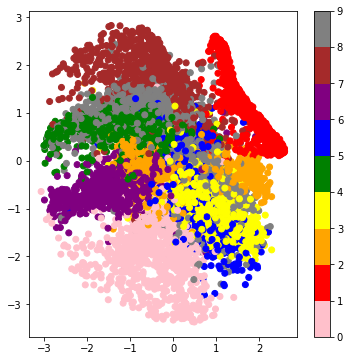

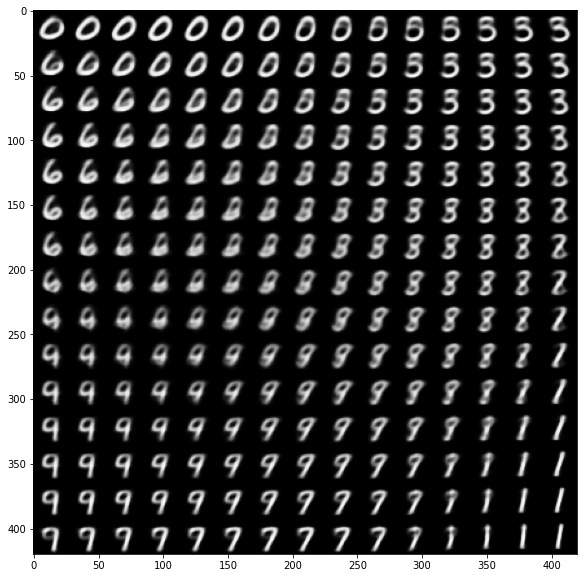

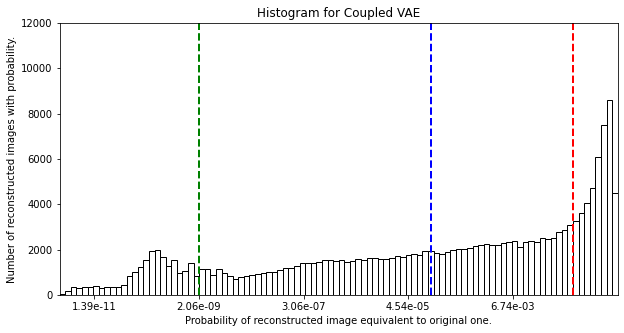

Decisiveness (Arithmetic Mean): -2.1518
Accuracy (Geometric Mean): -8.8952
Robustness (-2/3 Mean): -19.9944
Run time: 1.62 min

Coupling Distribution: 0.0001, Coupling Loss: 0.25, Seed: 0


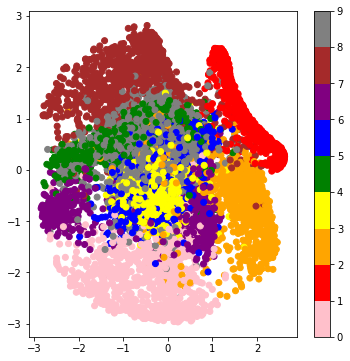

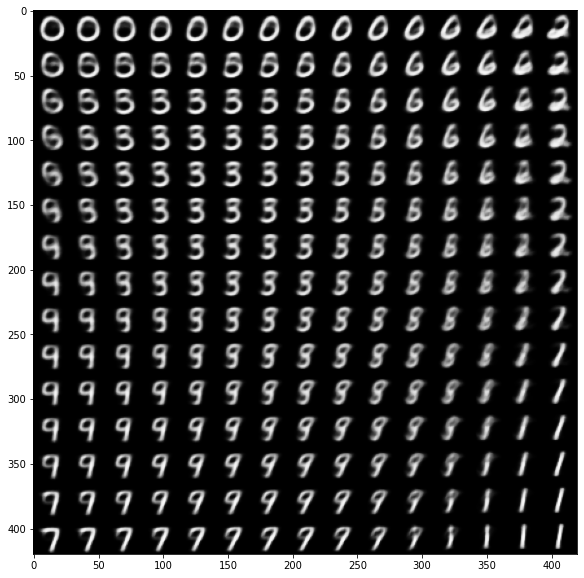

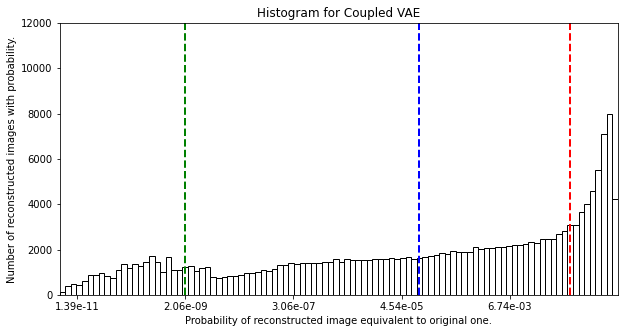

Decisiveness (Arithmetic Mean): -2.1851
Accuracy (Geometric Mean): -9.1840
Robustness (-2/3 Mean): -20.0384
Run time: 1.64 min

Coupling Distribution: 0.001, Coupling Loss: 0, Seed: 0


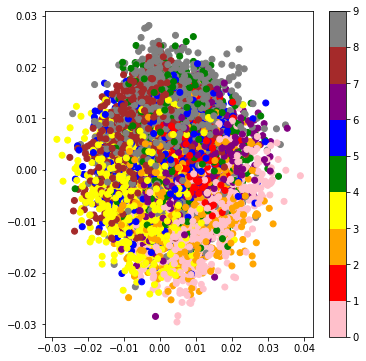

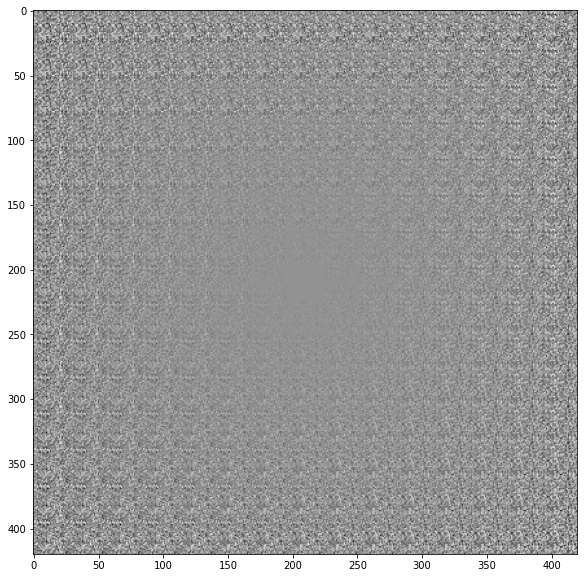

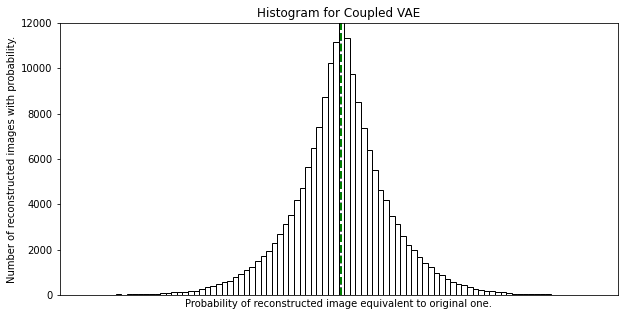

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.18 min

Coupling Distribution: 0.001, Coupling Loss: 0.025, Seed: 0


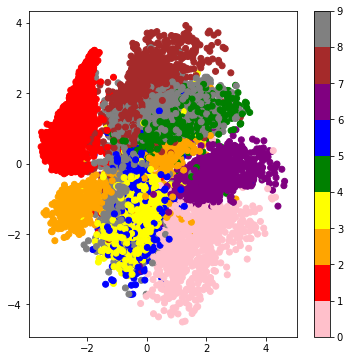

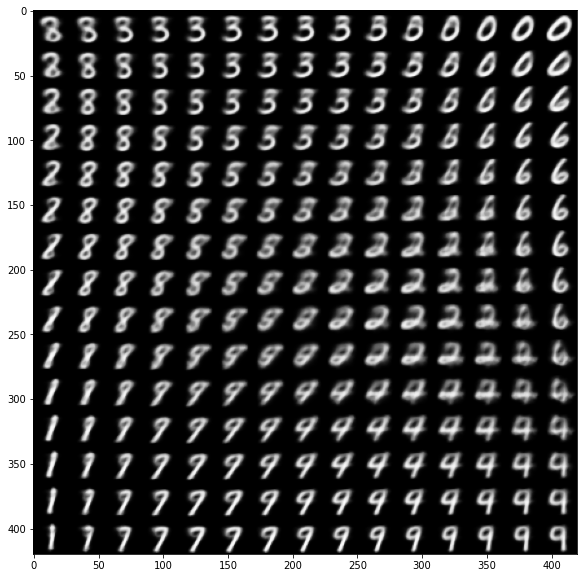

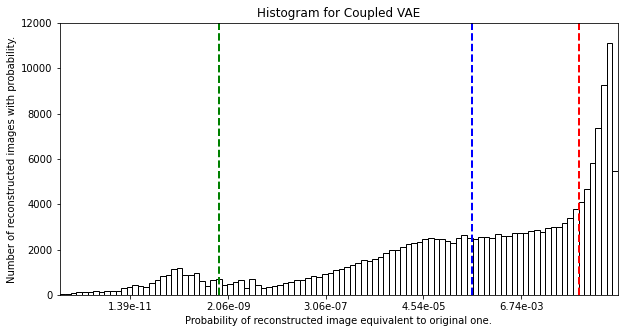

Decisiveness (Arithmetic Mean): -2.0531
Accuracy (Geometric Mean): -7.5152
Robustness (-2/3 Mean): -20.4650
Run time: 1.64 min

Coupling Distribution: 0.001, Coupling Loss: 0.05, Seed: 0


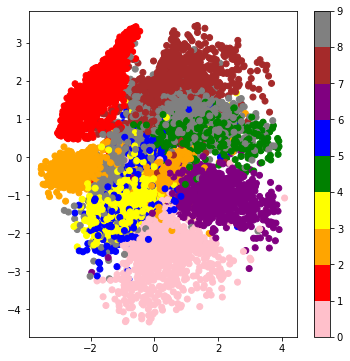

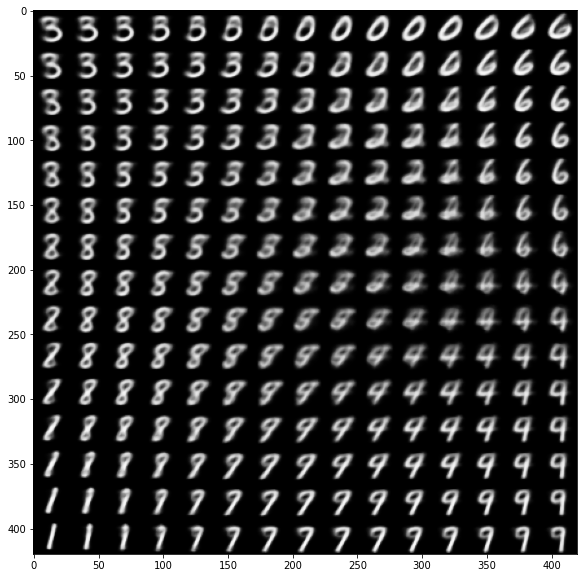

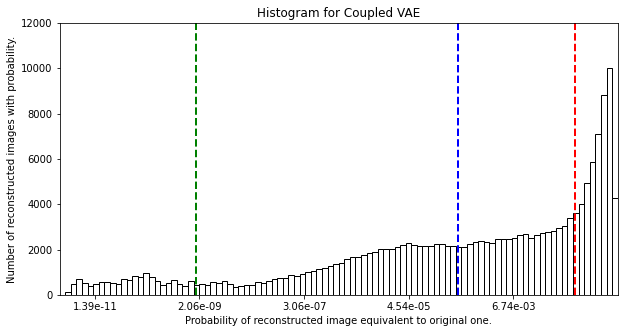

Decisiveness (Arithmetic Mean): -2.0483
Accuracy (Geometric Mean): -7.6227
Robustness (-2/3 Mean): -20.1651
Run time: 1.64 min

Coupling Distribution: 0.001, Coupling Loss: 0.075, Seed: 0


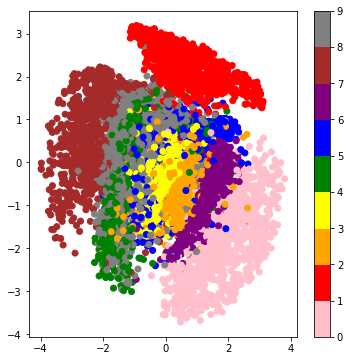

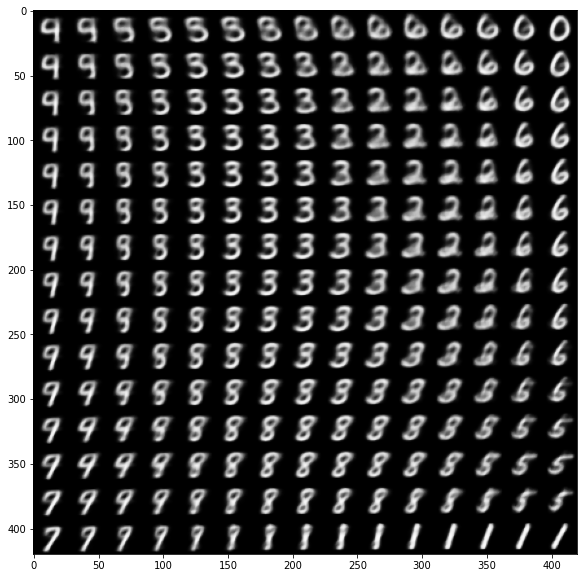

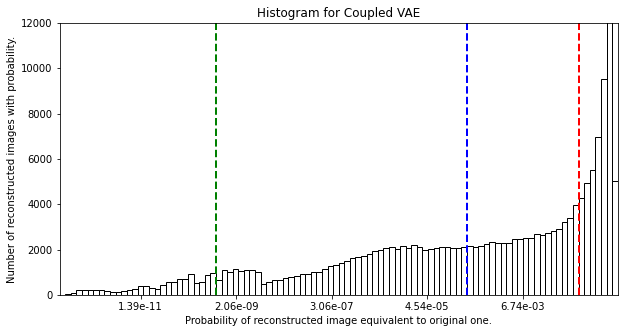

Decisiveness (Arithmetic Mean): -2.0415
Accuracy (Geometric Mean): -7.9369
Robustness (-2/3 Mean): -21.0382
Run time: 1.67 min

Coupling Distribution: 0.001, Coupling Loss: 0.1, Seed: 0


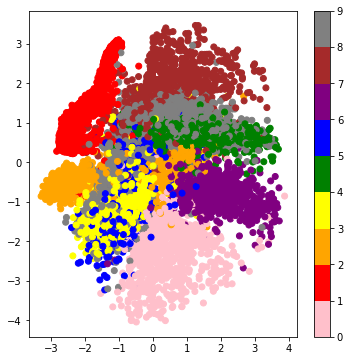

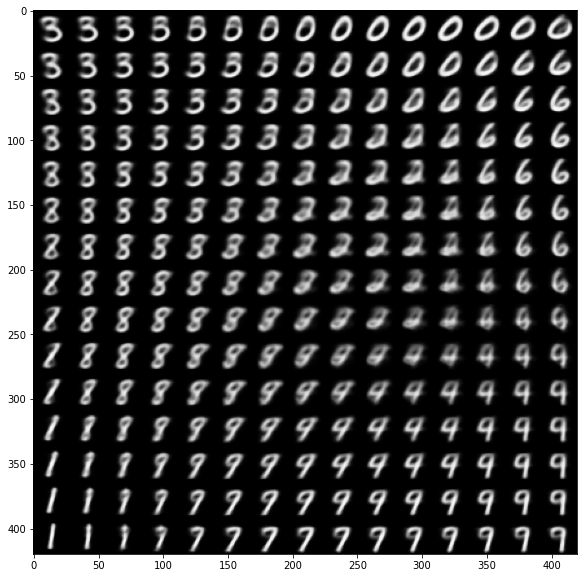

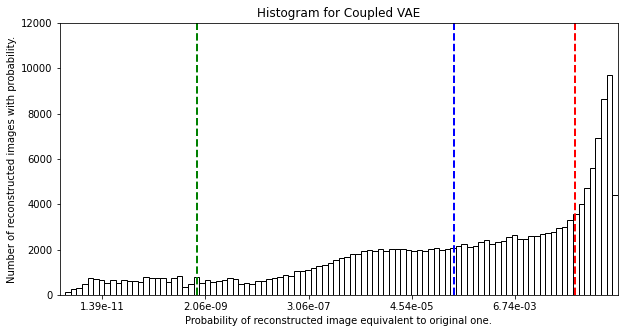

Decisiveness (Arithmetic Mean): -2.0711
Accuracy (Geometric Mean): -7.9505
Robustness (-2/3 Mean): -20.4052
Run time: 1.64 min

Coupling Distribution: 0.001, Coupling Loss: 0.125, Seed: 0


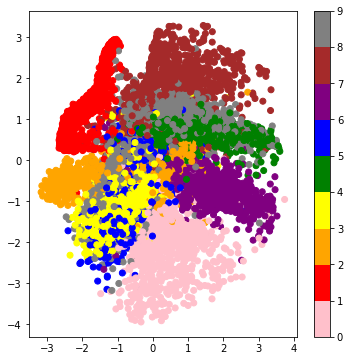

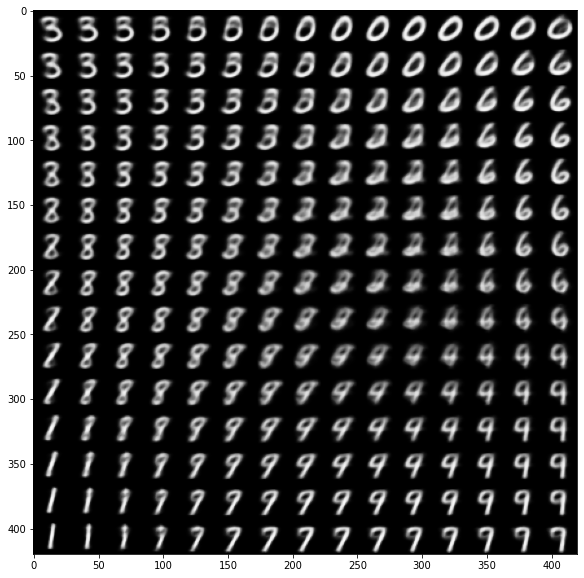

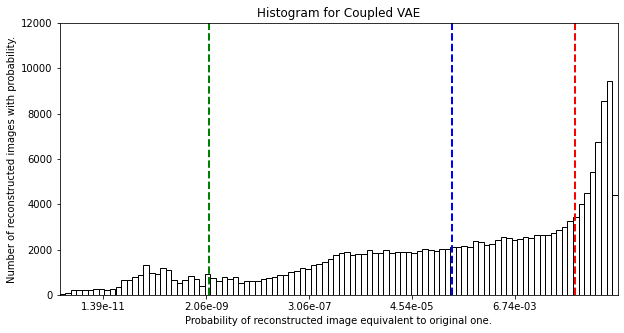

Decisiveness (Arithmetic Mean): -2.0893
Accuracy (Geometric Mean): -8.0760
Robustness (-2/3 Mean): -19.8928
Run time: 1.63 min

Coupling Distribution: 0.001, Coupling Loss: 0.15, Seed: 0


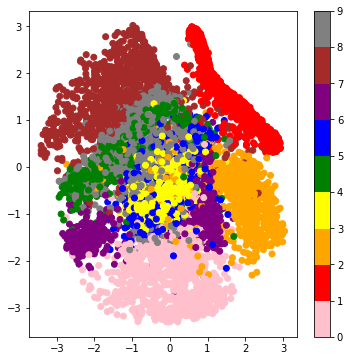

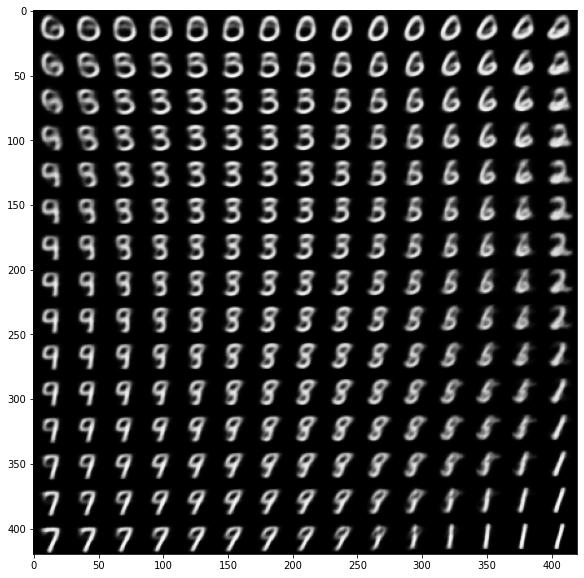

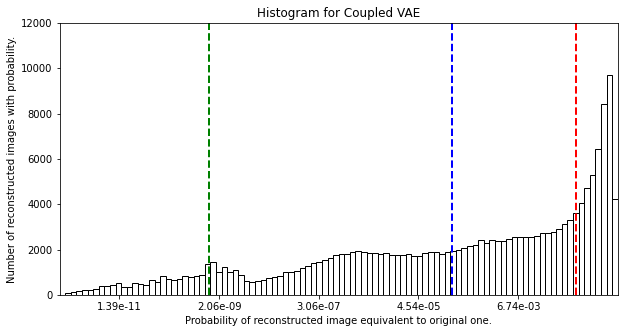

Decisiveness (Arithmetic Mean): -2.1173
Accuracy (Geometric Mean): -8.3243
Robustness (-2/3 Mean): -20.4890
Run time: 1.63 min

Coupling Distribution: 0.001, Coupling Loss: 0.175, Seed: 0


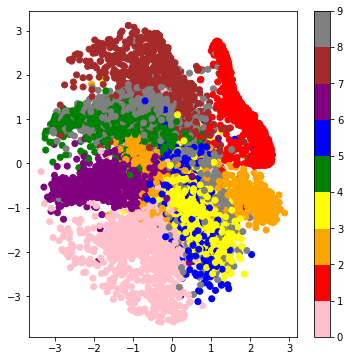

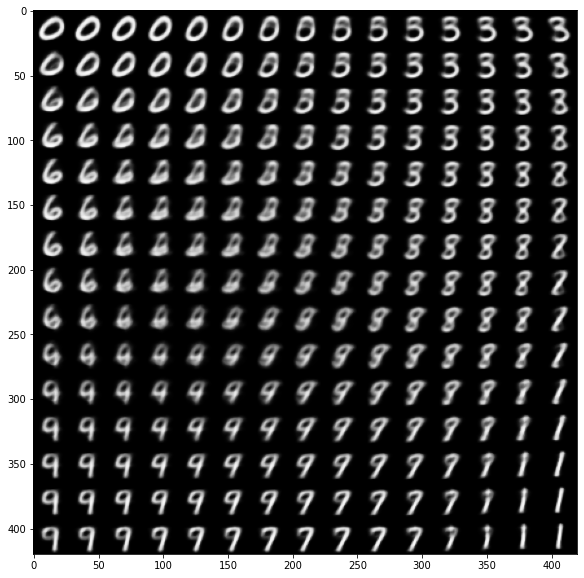

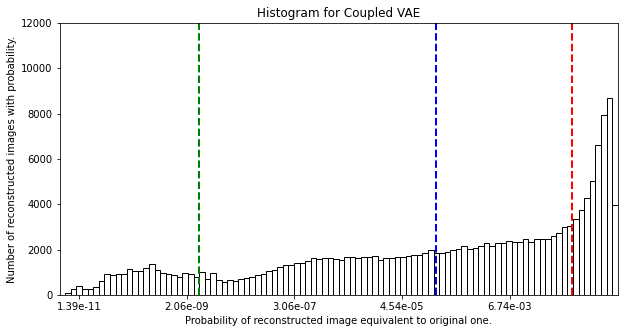

Decisiveness (Arithmetic Mean): -2.1189
Accuracy (Geometric Mean): -8.4293
Robustness (-2/3 Mean): -19.4206
Run time: 1.63 min

Coupling Distribution: 0.001, Coupling Loss: 0.2, Seed: 0


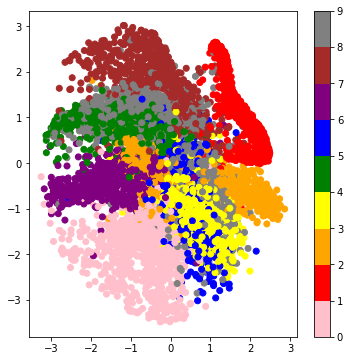

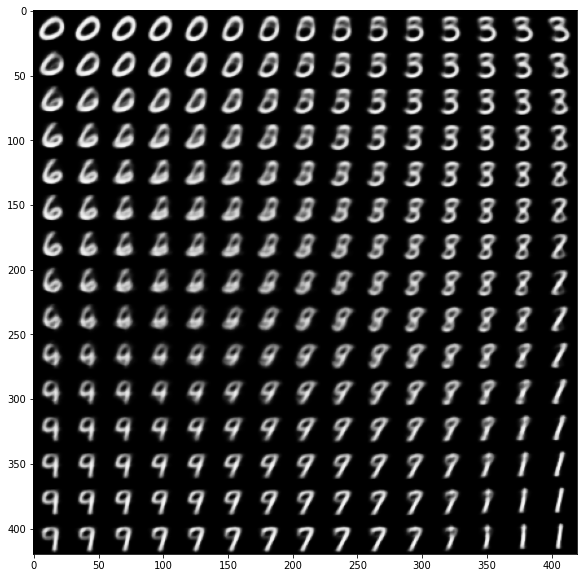

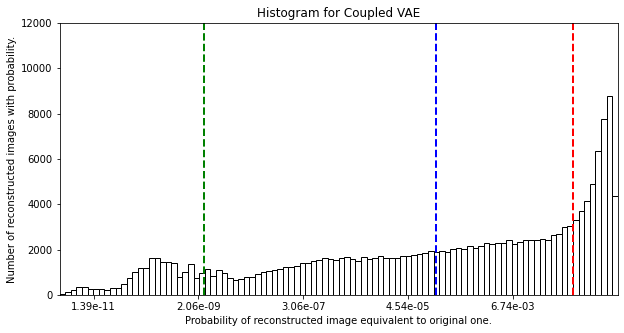

Decisiveness (Arithmetic Mean): -2.1360
Accuracy (Geometric Mean): -8.6525
Robustness (-2/3 Mean): -19.7417
Run time: 1.62 min

Coupling Distribution: 0.001, Coupling Loss: 0.225, Seed: 0


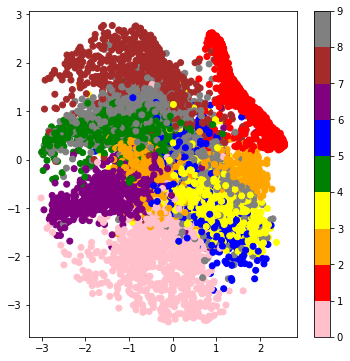

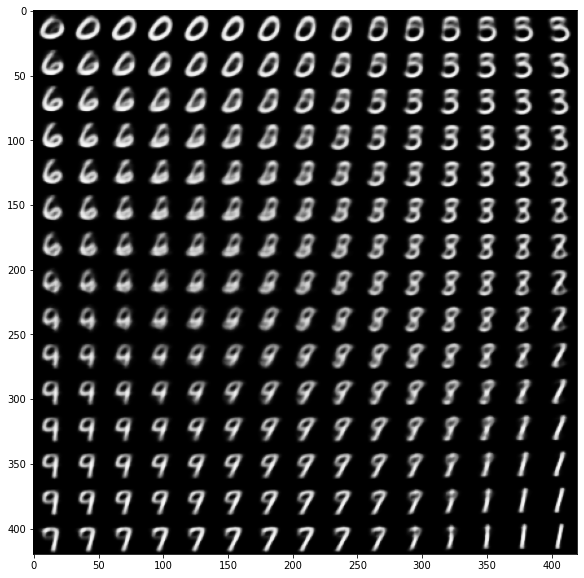

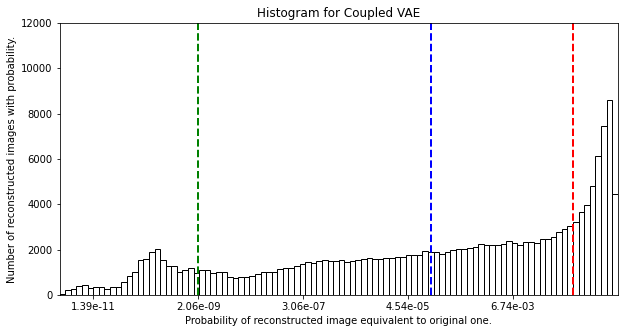

Decisiveness (Arithmetic Mean): -2.1527
Accuracy (Geometric Mean): -8.8947
Robustness (-2/3 Mean): -19.9999
Run time: 1.64 min

Coupling Distribution: 0.001, Coupling Loss: 0.25, Seed: 0


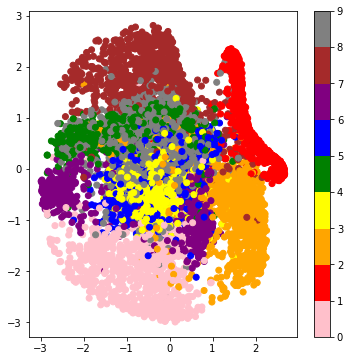

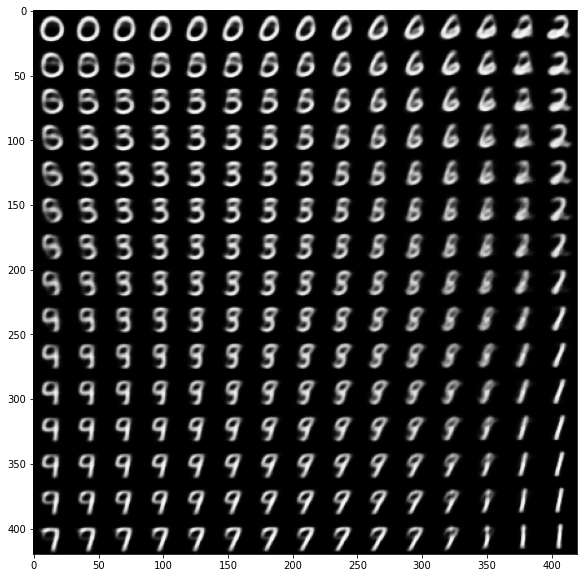

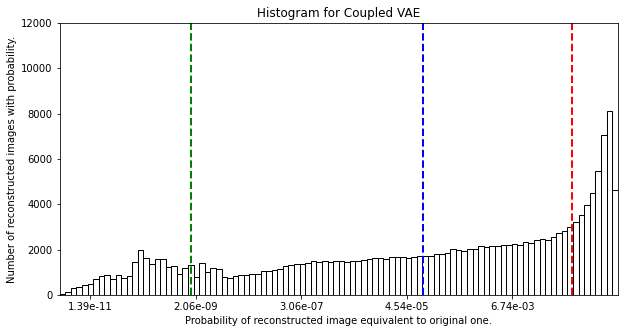

Decisiveness (Arithmetic Mean): -2.1862
Accuracy (Geometric Mean): -9.2068
Robustness (-2/3 Mean): -20.2038
Run time: 1.62 min

Coupling Distribution: 0.01, Coupling Loss: 0, Seed: 0


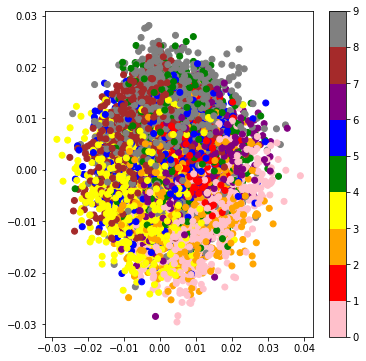

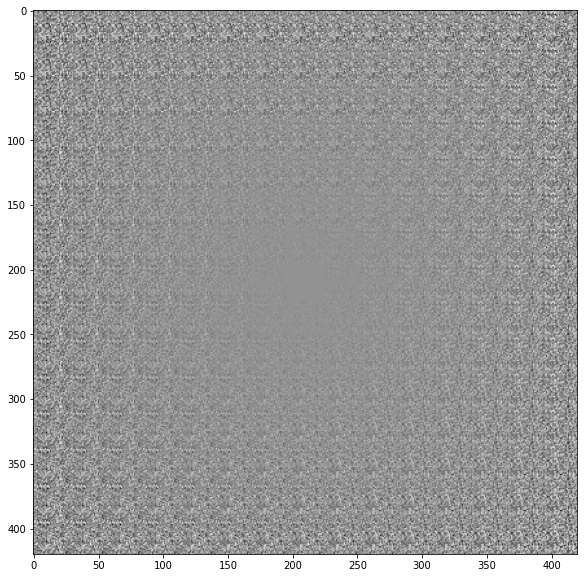

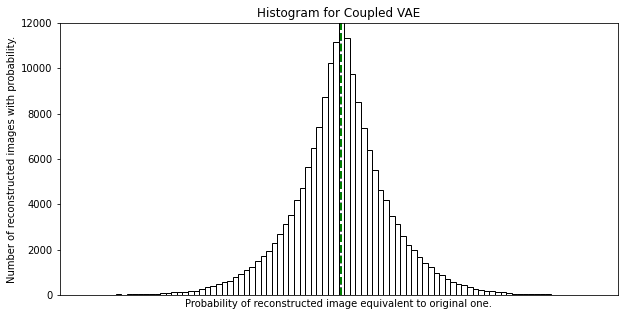

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.19 min

Coupling Distribution: 0.01, Coupling Loss: 0.025, Seed: 0


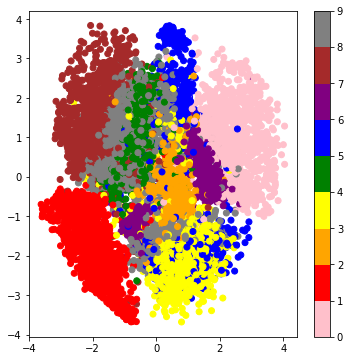

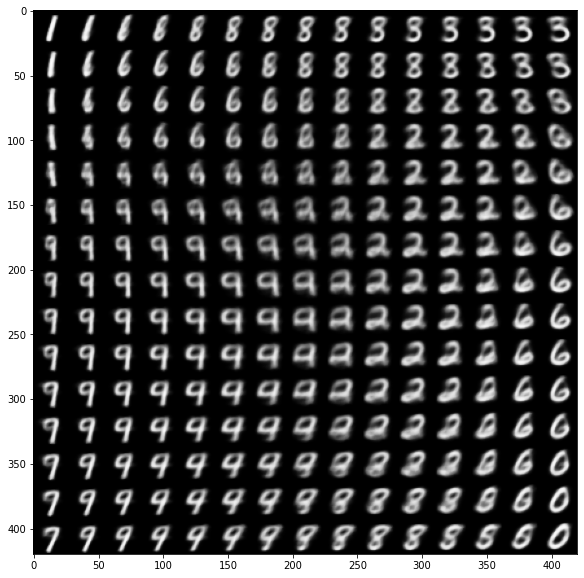

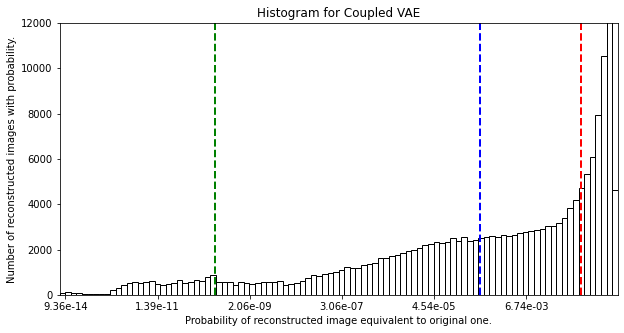

Decisiveness (Arithmetic Mean): -2.0221
Accuracy (Geometric Mean): -7.5224
Robustness (-2/3 Mean): -21.8991
Run time: 1.62 min

Coupling Distribution: 0.01, Coupling Loss: 0.05, Seed: 0


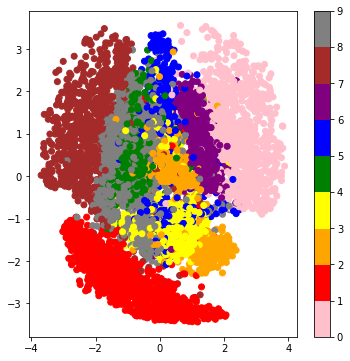

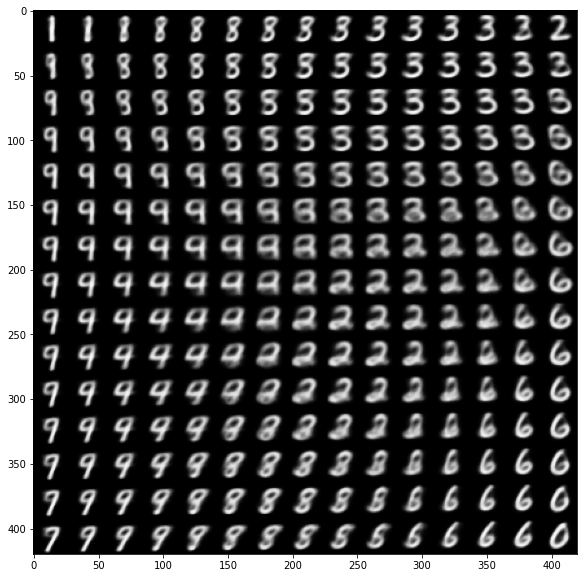

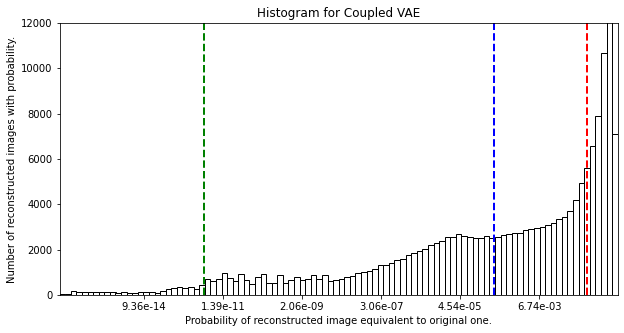

Decisiveness (Arithmetic Mean): -1.9970
Accuracy (Geometric Mean): -7.8831
Robustness (-2/3 Mean): -26.2156
Run time: 1.62 min

Coupling Distribution: 0.01, Coupling Loss: 0.075, Seed: 0


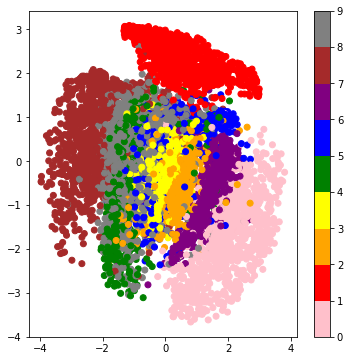

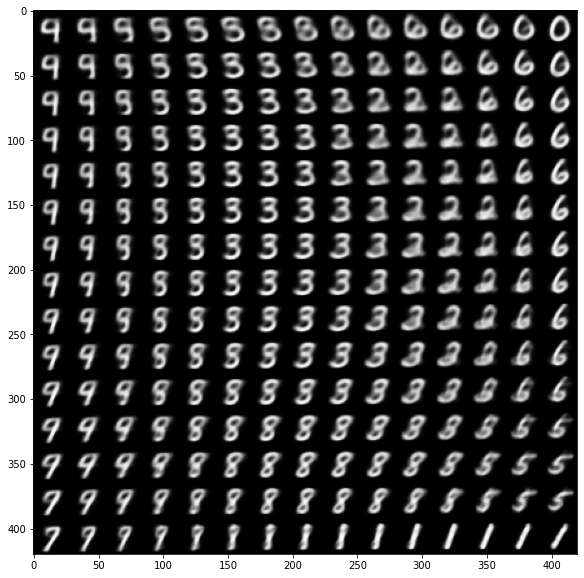

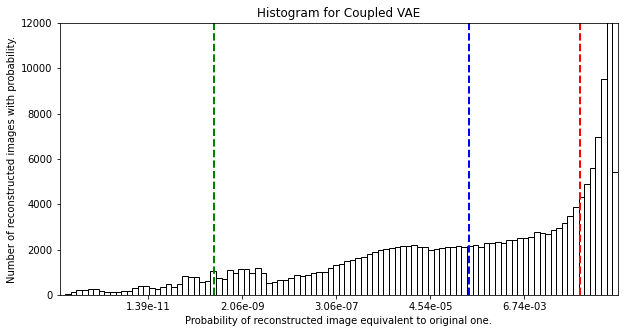

Decisiveness (Arithmetic Mean): -2.0422
Accuracy (Geometric Mean): -7.9500
Robustness (-2/3 Mean): -21.4770
Run time: 1.63 min

Coupling Distribution: 0.01, Coupling Loss: 0.1, Seed: 0


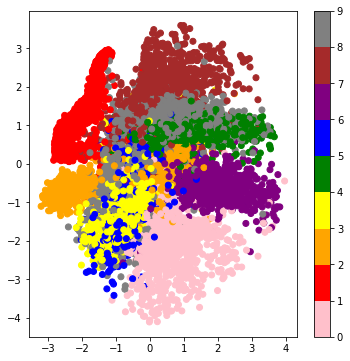

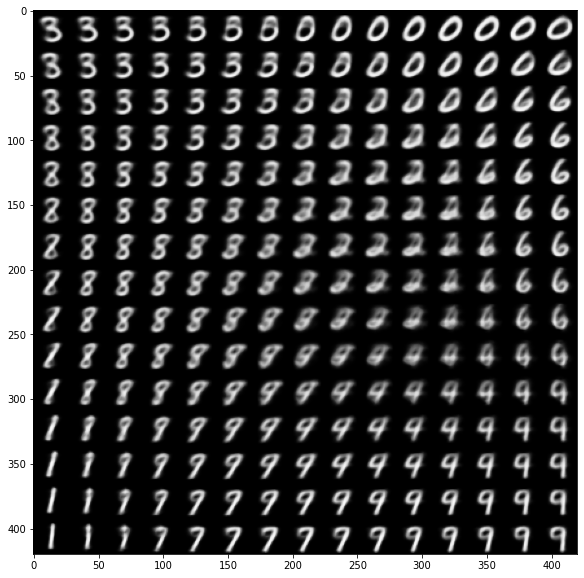

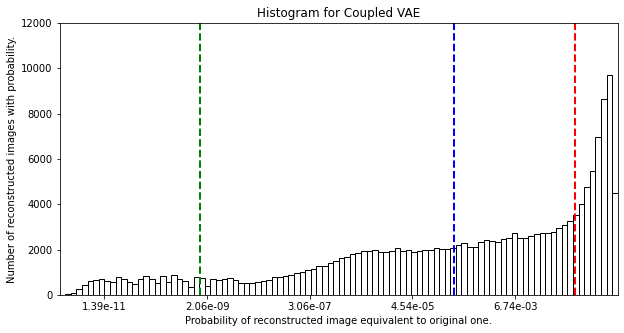

Decisiveness (Arithmetic Mean): -2.0723
Accuracy (Geometric Mean): -7.9564
Robustness (-2/3 Mean): -20.3469
Run time: 1.61 min

Coupling Distribution: 0.01, Coupling Loss: 0.125, Seed: 0


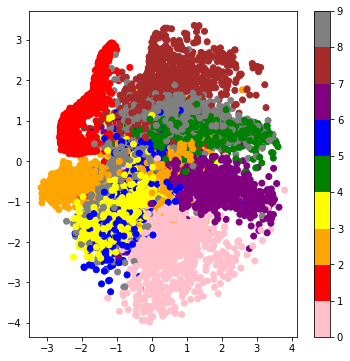

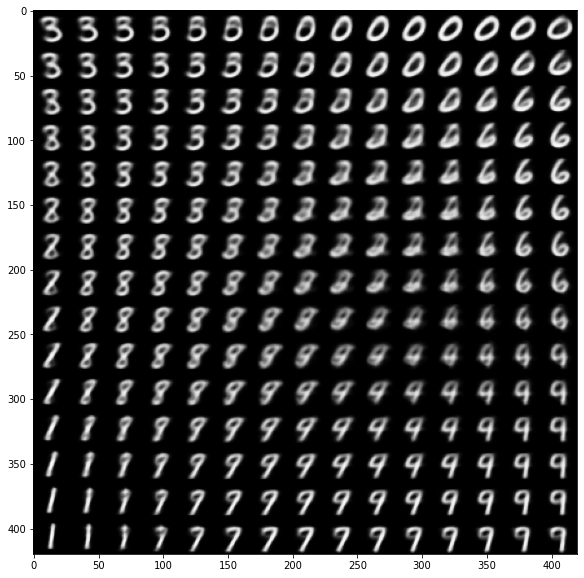

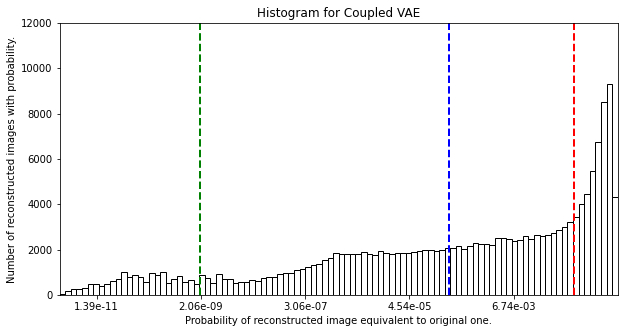

Decisiveness (Arithmetic Mean): -2.0901
Accuracy (Geometric Mean): -8.0978
Robustness (-2/3 Mean): -20.0396
Run time: 1.62 min

Coupling Distribution: 0.01, Coupling Loss: 0.15, Seed: 0


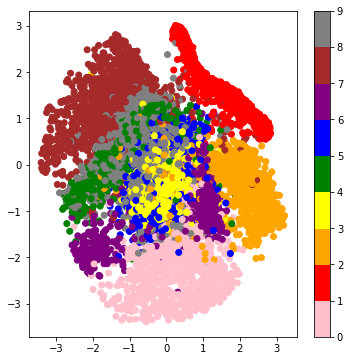

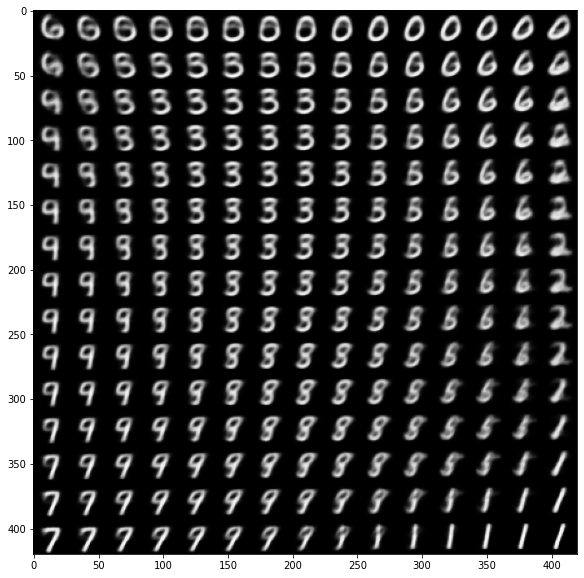

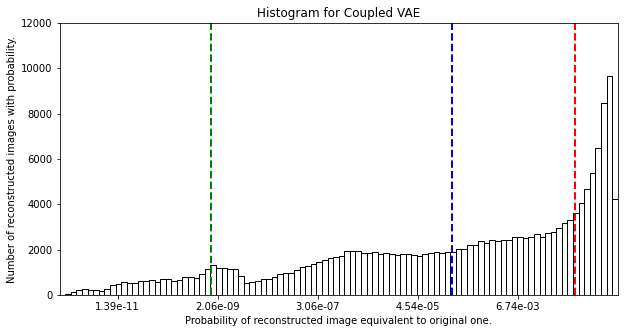

Decisiveness (Arithmetic Mean): -2.1149
Accuracy (Geometric Mean): -8.2844
Robustness (-2/3 Mean): -20.3477
Run time: 1.62 min

Coupling Distribution: 0.01, Coupling Loss: 0.175, Seed: 0


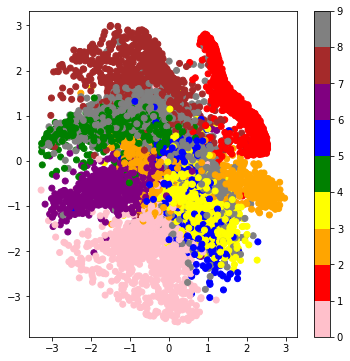

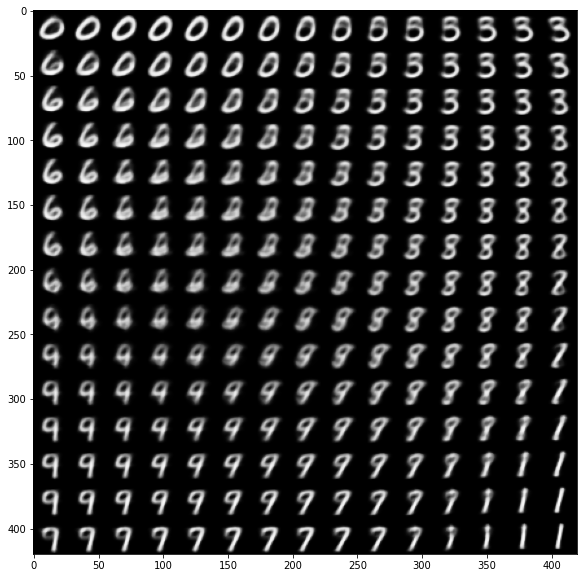

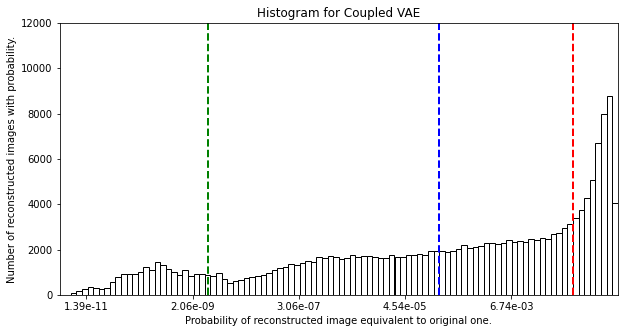

Decisiveness (Arithmetic Mean): -2.1193
Accuracy (Geometric Mean): -8.3922
Robustness (-2/3 Mean): -19.2886
Run time: 1.60 min

Coupling Distribution: 0.01, Coupling Loss: 0.2, Seed: 0


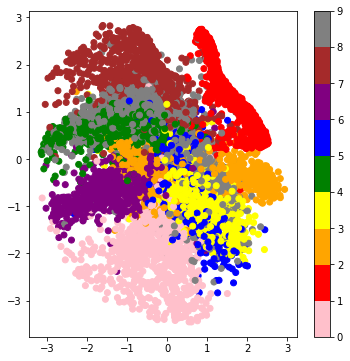

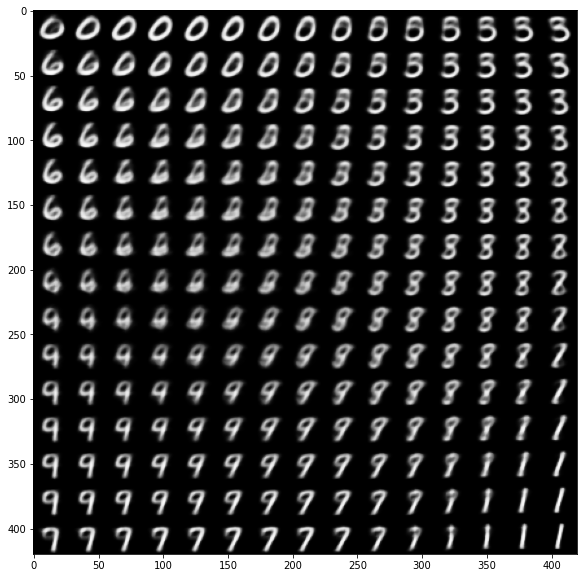

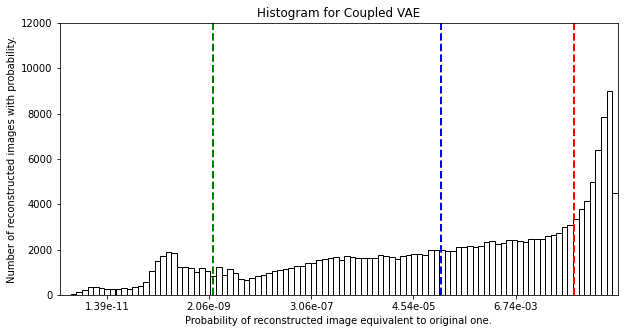

Decisiveness (Arithmetic Mean): -2.1377
Accuracy (Geometric Mean): -8.6494
Robustness (-2/3 Mean): -19.7911
Run time: 1.63 min

Coupling Distribution: 0.01, Coupling Loss: 0.225, Seed: 0


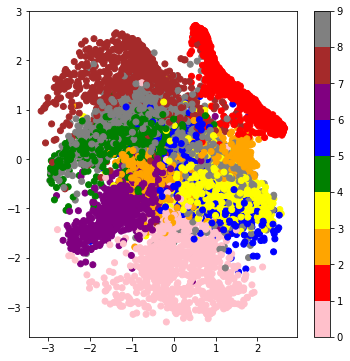

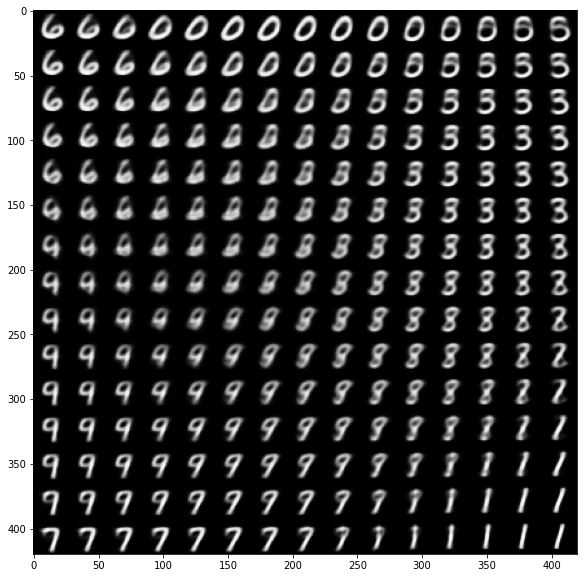

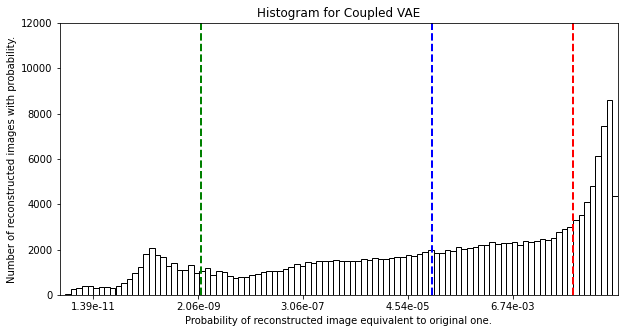

Decisiveness (Arithmetic Mean): -2.1552
Accuracy (Geometric Mean): -8.8742
Robustness (-2/3 Mean): -19.8649
Run time: 1.61 min

Coupling Distribution: 0.01, Coupling Loss: 0.25, Seed: 0


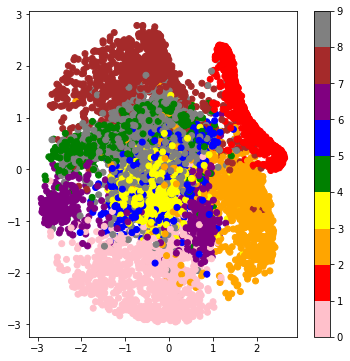

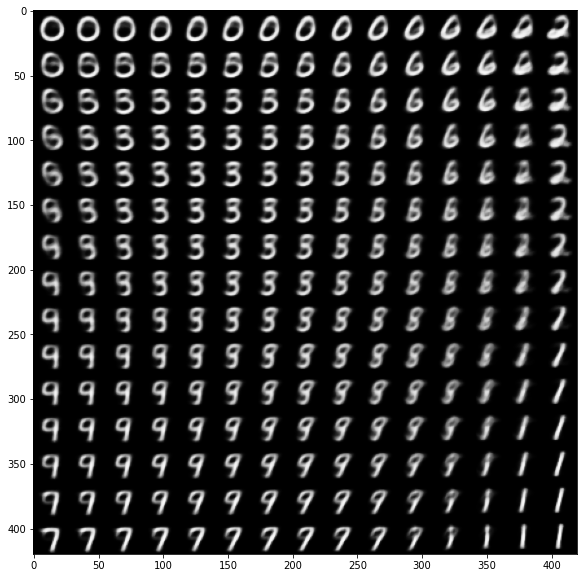

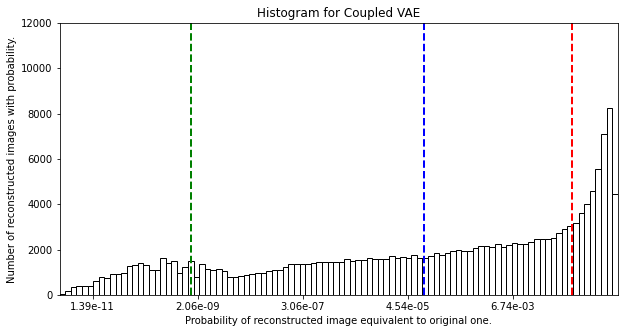

Decisiveness (Arithmetic Mean): -2.1869
Accuracy (Geometric Mean): -9.2185
Robustness (-2/3 Mean): -20.3420
Run time: 1.62 min

Coupling Distribution: 0.1, Coupling Loss: 0, Seed: 0


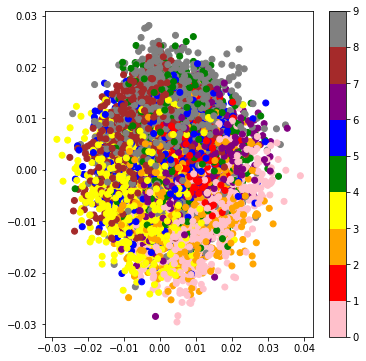

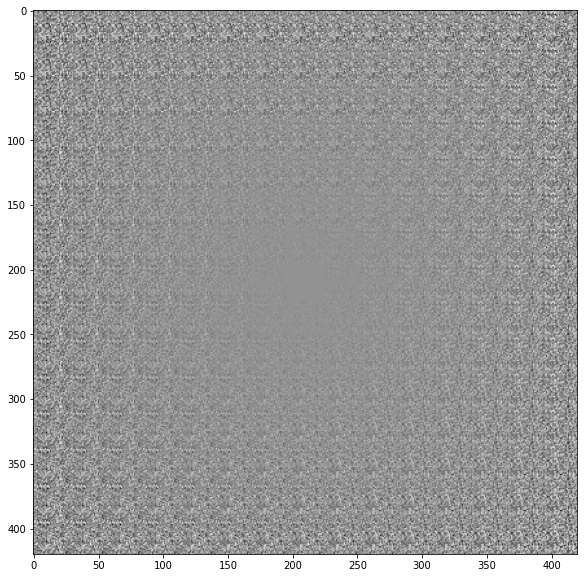

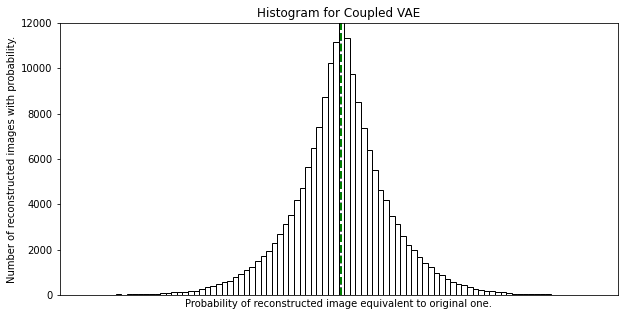

Decisiveness (Arithmetic Mean): -0.6931
Accuracy (Geometric Mean): -0.6932
Robustness (-2/3 Mean): -0.6933
Run time: 1.22 min

Coupling Distribution: 0.1, Coupling Loss: 0.025, Seed: 0


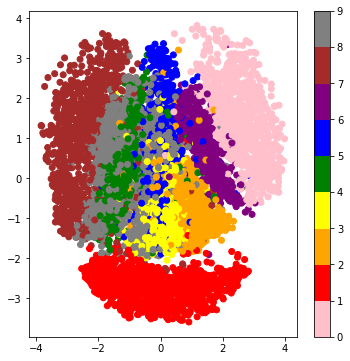

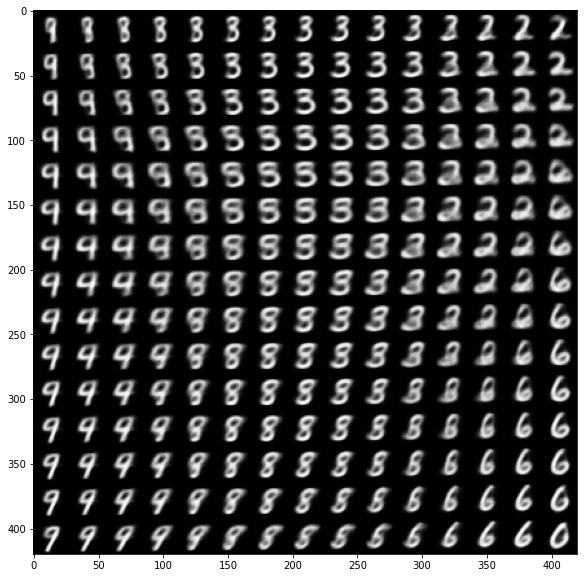

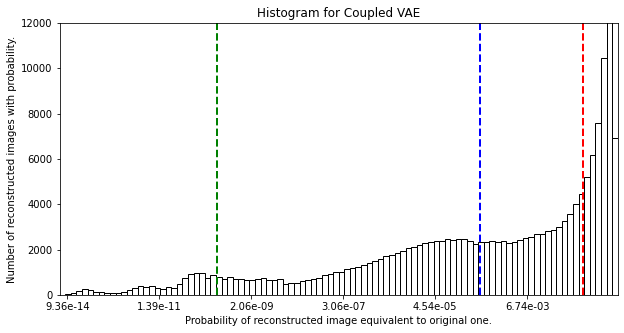

Decisiveness (Arithmetic Mean): -1.9703
Accuracy (Geometric Mean): -7.5502
Robustness (-2/3 Mean): -21.8892
Run time: 1.64 min

Coupling Distribution: 0.1, Coupling Loss: 0.05, Seed: 0


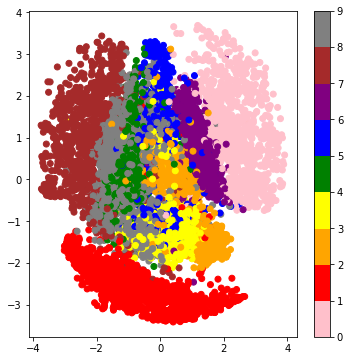

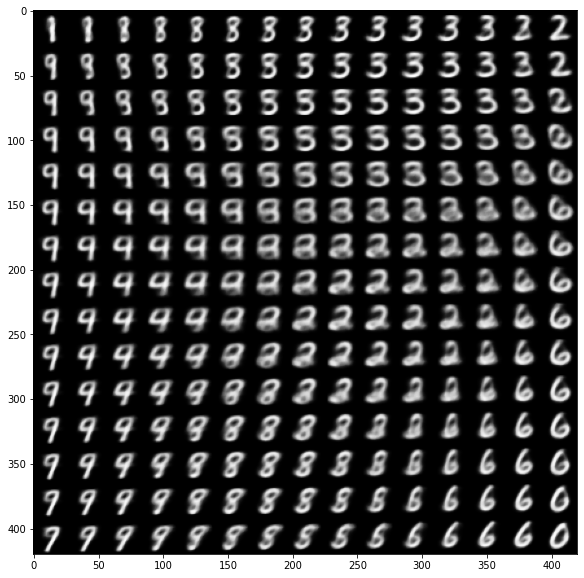

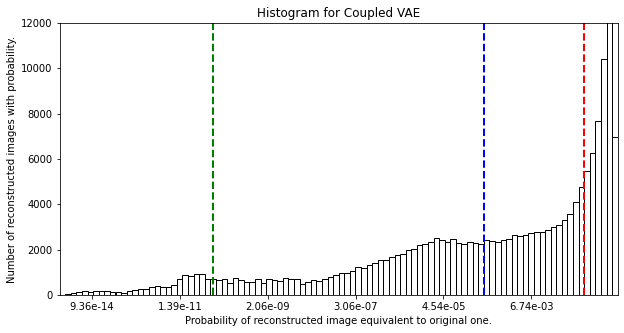

Decisiveness (Arithmetic Mean): -1.9824
Accuracy (Geometric Mean): -7.6980
Robustness (-2/3 Mean): -23.0847
Run time: 1.66 min

Coupling Distribution: 0.1, Coupling Loss: 0.075, Seed: 0


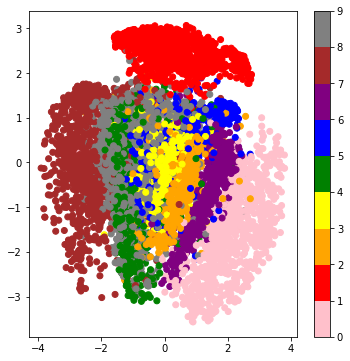

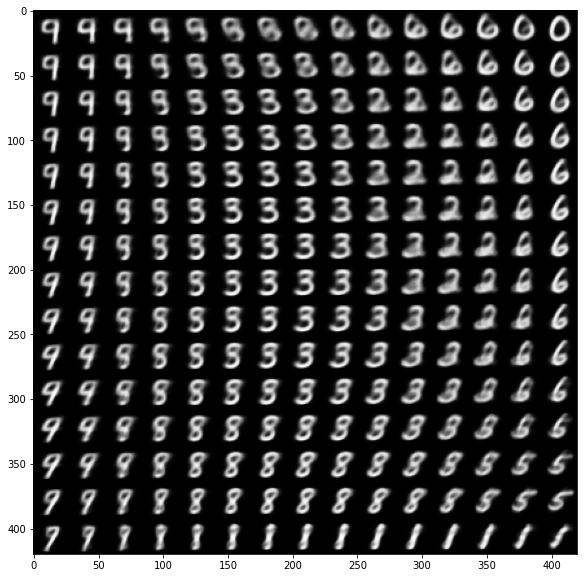

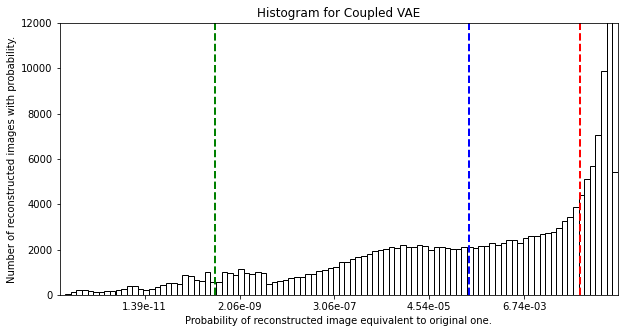

Decisiveness (Arithmetic Mean): -2.0428
Accuracy (Geometric Mean): -7.8942
Robustness (-2/3 Mean): -21.2917
Run time: 1.64 min

Coupling Distribution: 0.1, Coupling Loss: 0.1, Seed: 0


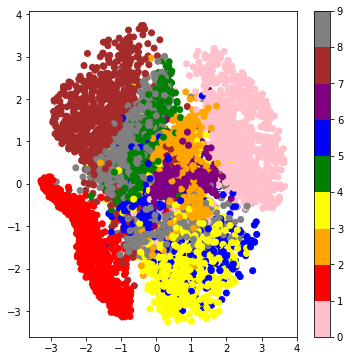

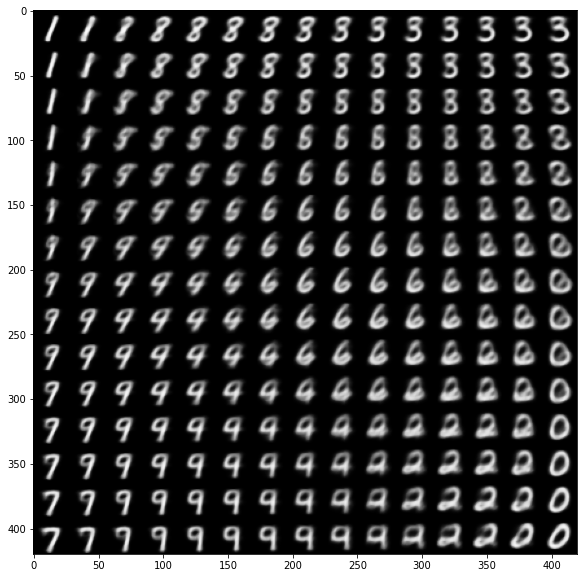

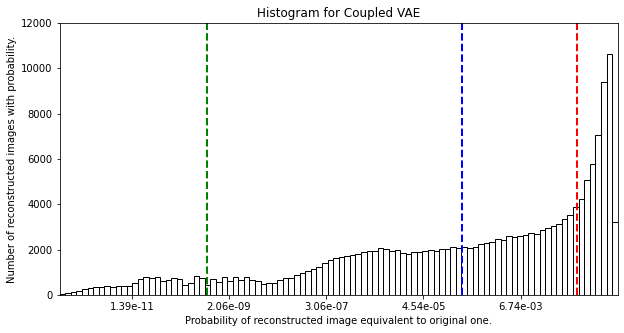

Decisiveness (Arithmetic Mean): -2.1074
Accuracy (Geometric Mean): -8.0352
Robustness (-2/3 Mean): -21.1397
Run time: 1.63 min

Coupling Distribution: 0.1, Coupling Loss: 0.125, Seed: 0


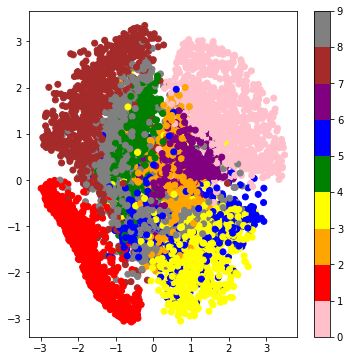

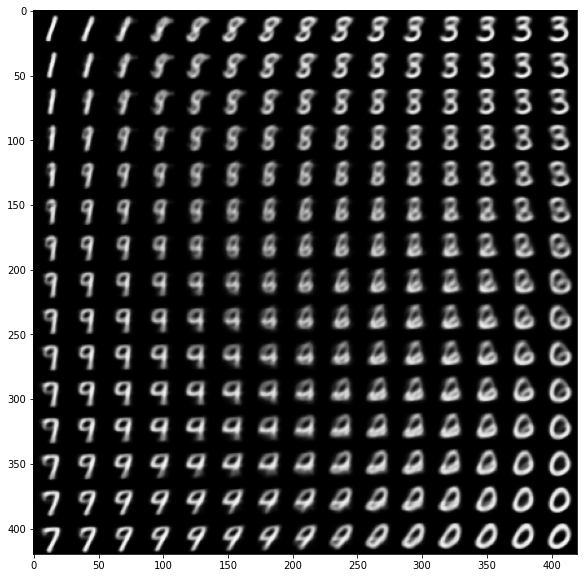

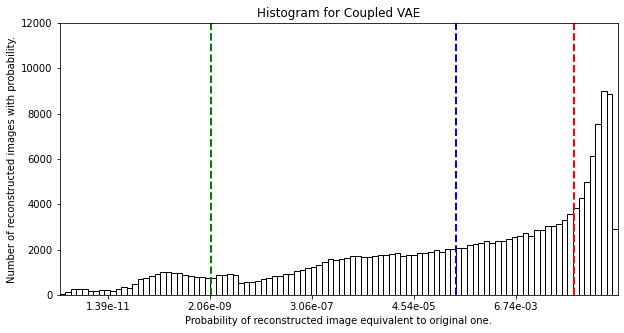

Decisiveness (Arithmetic Mean): -2.1297
Accuracy (Geometric Mean): -7.9366
Robustness (-2/3 Mean): -19.9642
Run time: 1.61 min

Coupling Distribution: 0.1, Coupling Loss: 0.15, Seed: 0


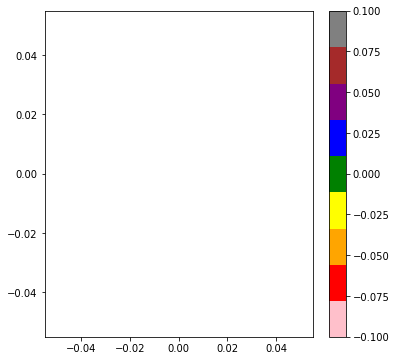

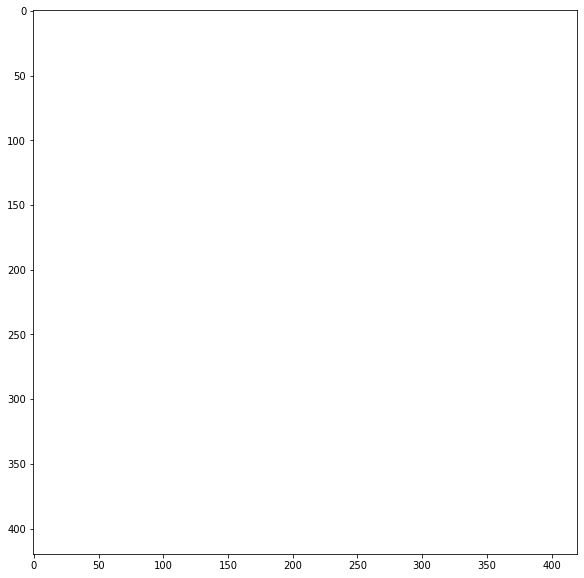

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.64 min

Coupling Distribution: 0.1, Coupling Loss: 0.175, Seed: 0


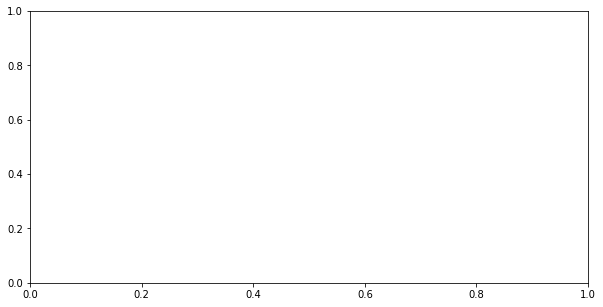

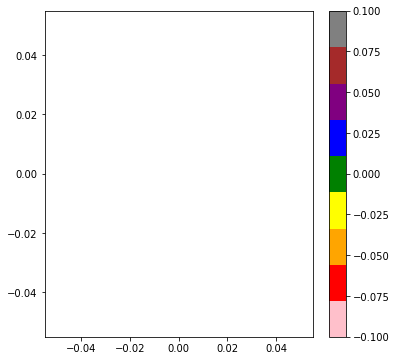

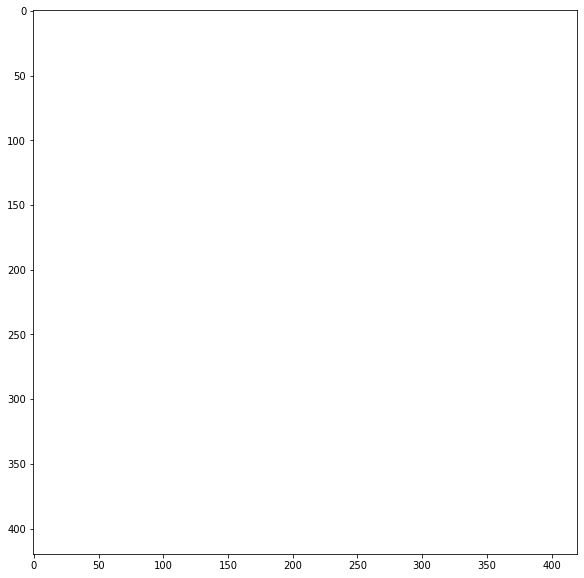

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.59 min

Coupling Distribution: 0.1, Coupling Loss: 0.2, Seed: 0


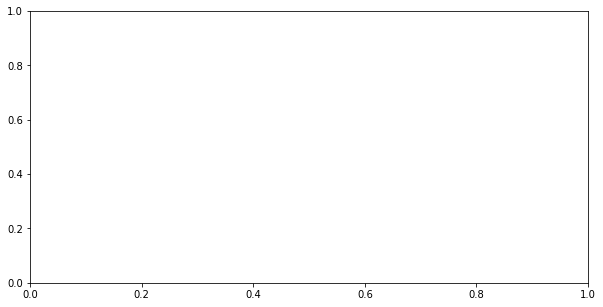

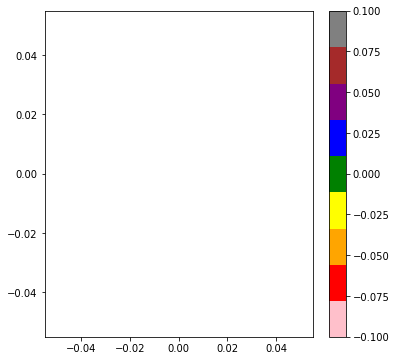

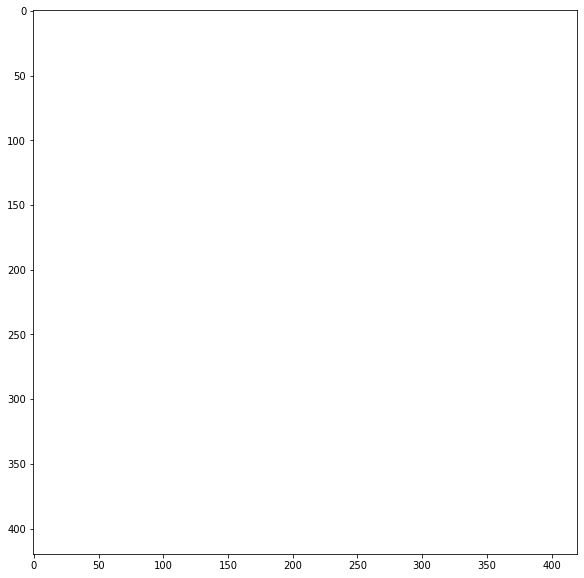

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.59 min

Coupling Distribution: 0.1, Coupling Loss: 0.225, Seed: 0


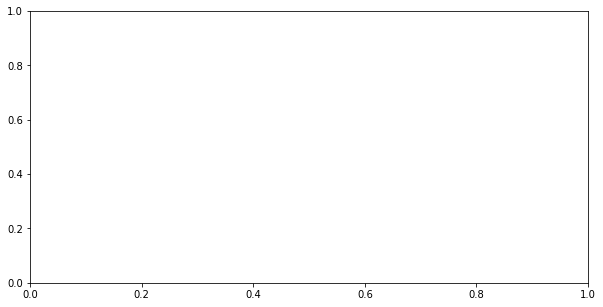

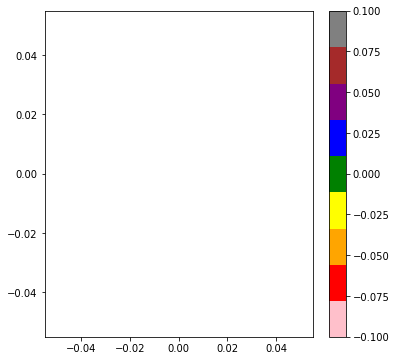

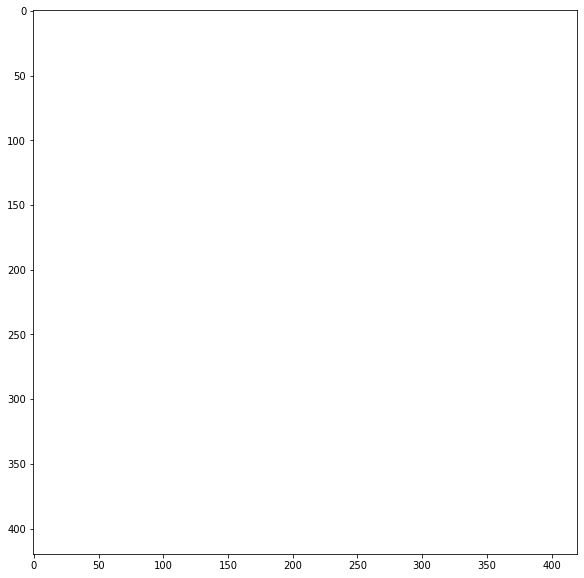

Failed to retrieve generalized mean values due to ValueError, thus set to NaN.
Run time: 1.59 min

Coupling Distribution: 0.1, Coupling Loss: 0.25, Seed: 0


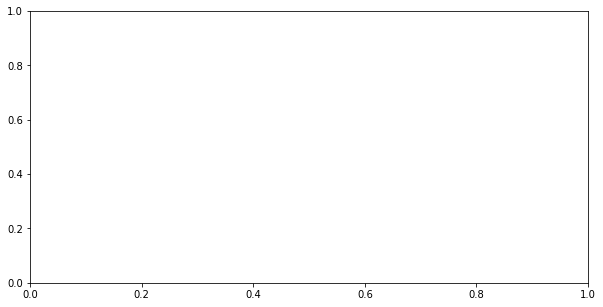

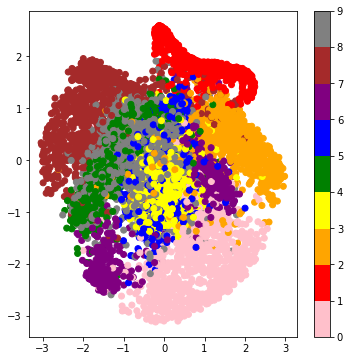

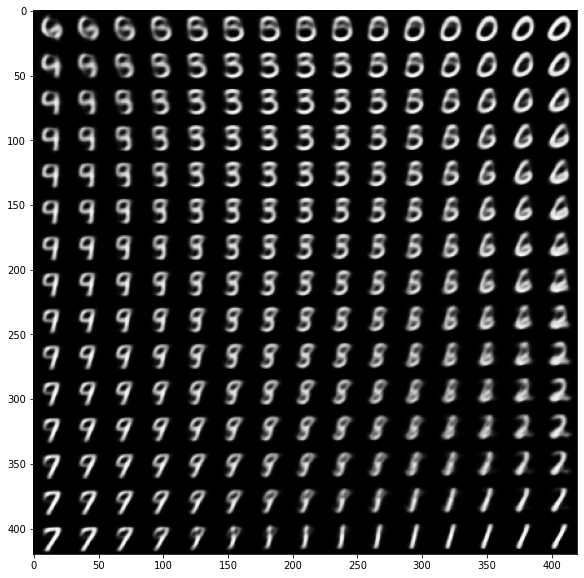

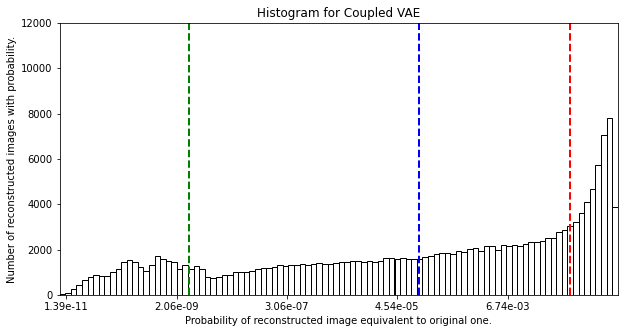

Decisiveness (Arithmetic Mean): -2.1917
Accuracy (Geometric Mean): -9.0231
Robustness (-2/3 Mean): -19.4238
Run time: 1.62 min

CPU times: user 2h 50min 20s, sys: 33min 5s, total: 3h 23min 25s
Wall time: 1h 58min 47s


In [11]:
%%time
comparison = run_cvae_loop(X_train, X_test, y_test, coupling_dist_list, coupling_loss_list, seed_list,
                           n_epoch=n_epoch, learning_rate=learning_rate, verbose=verbose
                           )

In [12]:
for seed in seed_list:
    print(comparison[seed])

    coupling_dist  coupling_loss  ...  log_accuracy  log_robustness
0             0.0          0.000  ...     -0.693219       -0.693273
1             0.0          0.025  ...     -7.675723      -25.029862
2             0.0          0.050  ...     -7.814022      -22.963940
3             0.0          0.075  ...     -7.933661      -20.623831
4             0.0          0.100  ...     -7.947443      -20.230651
..            ...            ...  ...           ...             ...
72            0.1          0.150  ...           NaN             NaN
73            0.1          0.175  ...           NaN             NaN
74            0.1          0.200  ...           NaN             NaN
75            0.1          0.225  ...           NaN             NaN
76            0.1          0.250  ...     -9.023101      -19.423789

[77 rows x 5 columns]


In [ ]:
comparison.to_csv("comparison.csv", header=True, index=False)